# Initialization

In [3]:
import re
import numpy as np
import scanpy as sc
import scanpy.external as sce
import anndata as ad
import pandas as pd
import statsmodels.api as sm
from statsmodels.formula.api import ols
from statsmodels.stats.multicomp import pairwise_tukeyhsd
from bbknn import bbknn
import venn
import matplotlib.pyplot as plt
import matplotlib.ticker as mtick
from math import ceil
import seaborn as sns
import decoupler as dc
from pydeseq2.dds import DeseqDataSet
from pydeseq2.default_inference import DefaultInference
from pydeseq2.ds import DeseqStats
from gprofiler import GProfiler
import omnipath
import importlib
import gc

# Modify the sys.path to include the notebook directory to import functions
import sys
import os

notebook_dir = os.path.abspath(os.path.join(os.getcwd(), '..'))
if notebook_dir not in sys.path:
    sys.path.append(notebook_dir)

import func_lib as f

importlib.reload(f)

# ignore pd performance warning
import warnings
warnings.simplefilter(action='ignore', category=pd.errors.PerformanceWarning)


# Set the random seed for reproducibility
seed = 2

# Data Read

In [4]:

adatas = {
    "D1" : sc.read_10x_mtx(
        "/Users/loganlarlham/Documents/Summer_proj_2024/Results_HT/collect_tube_1_batch_3_June_outs/filtered_feature_bc_matrix",
        var_names="gene_symbols",
        cache=False,
        make_unique=True,
        gex_only=False),
    "D2" : sc.read_10x_mtx(
        "/Users/loganlarlham/Documents/Summer_proj_2024/Results_HT/collect_tube_2_batch_3_june_outs/filtered_feature_bc_matrix",
        var_names="gene_symbols",
        cache=False,
        make_unique=True,
        gex_only=False),
    "D3" : sc.read_10x_mtx(
        "/Users/loganlarlham/Documents/Summer_proj_2024/Results_HT/Isol_Microglia_EFAD_TD_august_outs/filtered_feature_bc_matrix",
        var_names="gene_symbols",
        cache=False,
        make_unique=True,
        gex_only=False),
    "D4" : sc.read_10x_mtx(
        "/Users/loganlarlham/Documents/Summer_proj_2024/Results_HT/MICROGLIA_E3E4FAD_TD_23_05_2023_outs/filtered_feature_bc_matrix",
        var_names="gene_symbols",
        cache=False,
        make_unique=True,
        gex_only=False),
    "D5" : sc.read_10x_mtx(
        "/Users/loganlarlham/Documents/Summer_proj_2024/Results_HT/Tube_1_July_20_TD_YYRFC_outs/filtered_feature_bc_matrix",
        var_names="gene_symbols",
        cache=False,
        make_unique=True,
        gex_only=False),
    "D6" : sc.read_10x_mtx(
        "/Users/loganlarlham/Documents/Summer_proj_2024/Results_HT/Tube2_July_20_TD_outs/filtered_feature_bc_matrix",
        var_names="gene_symbols",
        cache=False,
        make_unique=True,
        gex_only=False),
    "D7" : sc.read_10x_mtx(
        "/Users/loganlarlham/Documents/Summer_proj_2024/Results_HT/Tube3_july_20_TD_outs/filtered_feature_bc_matrix",
        var_names="gene_symbols",
        cache=False,
        make_unique=True,
        gex_only=False),
    "D8" : sc.read_10x_mtx(
        "/Users/loganlarlham/Documents/Summer_proj_2024/Results_HT/Isol_microglia_EFAD_Sept_outs/outs/filtered_feature_bc_matrix",
        var_names="gene_symbols",
        cache=False,
        make_unique=True,
        gex_only=False),
    }

# genotype and treatment map for samples
genotype_map = {"K191" : "E3FAD", "K192" : "E3FAD", "K190" : "E3WT", "K193" : "E3WT", 
                "G118" : "E4FAD", "G119" : "E4FAD", "G120" : "E4FAD", "G122" : "E4WT",
                "K231" : "E3FAD", "K233" : "E3FAD", "K234" : "E3FAD", "K219" : "E4FAD",
                "G143" : "E4WT", "G146" : "E4WT", "K232" : "E3WT", "G180" : "E4WT", 
                "G183" : "E4WT", "G184" : "E4WT", "G185" : "E4WT", "G186" : "E4FAD",
                "K248" : "E3WT", "K249" : "E3WT", "K250" : "E3FAD", "K252" : "E3FAD", 
                "G177" : "E4FAD", "G178" : "E4FAD", "G179" : "E4FAD", "G145" : "E4FAD",
                "K257" : "E3WT", "K261" : "E3WT", "K262" : "E3WT", "K268" : "E3FAD",
                "K283" : "E3WT", "K284" : "E3FAD"}
treatment_map = {"K191" : "LPS", "K192" : "LPS", "K190" : "LPS", "K193" : "LPS", 
                "G118" : "VEHICLE", "G119" : "VEHICLE", "G120" : "VEHICLE", "G122" : "VEHICLE",
                "K231" : "VEHICLE", "K233" : "VEHICLE", "K234" : "VEHICLE", "K219" : "LPS",
                "G143" : "LPS", "G146" : "LPS", "K232" : "VEHICLE", "G180" : "LPS", 
                "G183" : "VEHICLE", "G184" : "VEHICLE", "G185" : "VEHICLE", "G186" : "VEHICLE",
                "K248" : "LPS", "K249" : "LPS", "K250" : "LPS", "K252" : "LPS", 
                "G177" : "LPS", "G178" : "LPS", "G179" : "LPS", "G145" : "LPS",
                "K257" : "VEHICLE", "K261" : "VEHICLE", "K262" : "VEHICLE", "K268" : "VEHICLE",
                "K283" : "LPS", "K284" : "LPS"}


# Load the CSV file containing manual annotations
manual_annotations = pd.read_csv('manual_annotation.csv', index_col=0)




In [5]:
print(f"Number of hashtags in D8: {adatas['D8'].var[adatas['D8'].var['feature_types'] == 'Antibody Capture'].shape[0]}")
for idx, row in adatas["D8"].var.iterrows():
    if row["feature_types"] == "Antibody Capture":
        print(f"gene_ids: {row['gene_ids']}")
        print(f"index: {idx}")
        # Convert the feature name to an integer index
        col_index = adatas['D8'].var_names.get_loc(idx)
        # Use the integer index to access the data
        count = adatas['D8'].X[:, col_index].sum()
        print(f"Number of {idx} in D8: {count}")
        print("\n")

Number of hashtags in D8: 4
gene_ids: Hashtag_1
index: K257
Number of K257 in D8: 1327360.0


gene_ids: Hashtag_2
index: K261
Number of K261 in D8: 205424.0


gene_ids: Hashtag_3
index: K262
Number of K262 in D8: 410.0


gene_ids: Hashtag_4
index: K268
Number of K268 in D8: 2.0




# Rename Hahtags in Dataset 8

In [6]:
# The index of the rows which are feature_types == antibody capture of D8 is incorrect, so we need to fix it



# Print the number of cells in D8
print(f"Number of vars in D8: {adatas['D8'].var.shape[0]}")

# Create a copy of the var DataFrame for modification
var_df = adatas['D8'].var.copy()

# Create a list to store indices of variables to remove
variables_to_remove = []

# Create a dictionary to map old variable names to new ones
rename_dict = {}

# Iterate over the var DataFrame
for index, row in var_df.iterrows():
    if row["feature_types"] == "Antibody Capture":
        if row['gene_ids'] == "Hashtag_1":
            # Rename 'Hashtag_1' to 'K283'
            rename_dict[index] = 'K283'
        elif row['gene_ids'] == "Hashtag_2":
            # Rename 'Hashtag_2' to 'K284'
            rename_dict[index] = 'K284'
        elif row['gene_ids'] == "Hashtag_3":
            # Add the index to the list of variables to remove
            variables_to_remove.append(index)
        elif row['gene_ids'] == "Hashtag_4":
            variables_to_remove.append(index)

# Apply the renaming to var
var_df.rename(index=rename_dict, inplace=True)

# Update the var DataFrame in the AnnData object
adatas['D8'].var = var_df

# Update var_names to match var.index
adatas['D8'].var_names = var_df.index

# Remove the variables from the AnnData object
adatas['D8'] = adatas['D8'][:, ~adatas['D8'].var.index.isin(variables_to_remove)]

print(f"Number of vars in D8 after removing hashtag_3/4: {adatas['D8'].var.shape[0]}")

# Verify the changes
for index, row in adatas["D8"].var.iterrows():
    if row["feature_types"] == "Antibody Capture":
        print(f"gene_ids: {row['gene_ids']}")
        print(f"index: {index}")
        print("\n")

Number of vars in D8: 33993
Number of vars in D8 after removing hashtag_3/4: 33991
gene_ids: Hashtag_1
index: K283


gene_ids: Hashtag_2
index: K284




# Demultiplex by HTO

In [7]:
for adata in adatas.values():
    hashtag_var_mask = adata.var['feature_types'] == 'Antibody Capture'
    hashtag_vars = adata.var_names[hashtag_var_mask]
    print(hashtag_vars)
    for hashtag_var in hashtag_vars:
        # .X is typically in CSR format, so convert to array for the single column
        # (take .A1 or .toarray()[:, 0] or similar)
        adata.obs[hashtag_var] = adata[:, hashtag_var].X.toarray().ravel()
        print(adata.obs.columns)
        print(adata.obs[hashtag_var])

Index(['K231', 'K233', 'K234', 'K219'], dtype='object')
Index(['K231'], dtype='object')
AAACCCACACACCTAA-1      5.0
AAACCCACACTGTGTA-1      5.0
AAACCCAGTTCTTGCC-1    356.0
AAACGAATCATTCCTA-1      3.0
AAACGCTAGACGCCAA-1     97.0
                      ...  
TTTGGTTTCGCGTGCA-1      2.0
TTTGTTGAGCGCTTCG-1    660.0
TTTGTTGAGCTAATCC-1      5.0
TTTGTTGCAACTGCTA-1    261.0
TTTGTTGGTGCCTTCT-1      4.0
Name: K231, Length: 3723, dtype: float32
Index(['K231', 'K233'], dtype='object')
AAACCCACACACCTAA-1     6.0
AAACCCACACTGTGTA-1     4.0
AAACCCAGTTCTTGCC-1    11.0
AAACGAATCATTCCTA-1     6.0
AAACGCTAGACGCCAA-1     3.0
                      ... 
TTTGGTTTCGCGTGCA-1     6.0
TTTGTTGAGCGCTTCG-1     1.0
TTTGTTGAGCTAATCC-1     5.0
TTTGTTGCAACTGCTA-1     8.0
TTTGTTGGTGCCTTCT-1     8.0
Name: K233, Length: 3723, dtype: float32
Index(['K231', 'K233', 'K234'], dtype='object')
AAACCCACACACCTAA-1      1.0
AAACCCACACTGTGTA-1      5.0
AAACCCAGTTCTTGCC-1      3.0
AAACGAATCATTCCTA-1    283.0
AAACGCTAGACGCCAA-1      7

/var/folders/n8/l_thwp511tqdnvx3xvmjy3y80000gn/T/ipykernel_55331/504224979.py:8: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs[hashtag_var] = adata[:, hashtag_var].X.toarray().ravel()


In [8]:
#Demultiplex hashtags from datasets
for adata_key, adata in adatas.items():
    print(f"{adata_key}:")
    if adata_key == "D8":
        f.hash_demulitplex(adata, hashtag_vars, number_of_noise_barcodes=1)
    else:
        f.hash_demulitplex(adata, adata.obs.columns)
    print("\n")

D1:
Please cite HashSolo paper:
https://www.cell.com/cell-systems/fulltext/S2405-4712(20)30195-2
Number of predicted singlets: 3403
Number of predicted doublets: 255
Number of predicted negatives: 65
Number of cells for each hashtag:
K234: 880
K219: 874
K233: 851
K231: 798
Doublet: 255
Negative: 65


D2:
Please cite HashSolo paper:
https://www.cell.com/cell-systems/fulltext/S2405-4712(20)30195-2
Number of predicted singlets: 5041
Number of predicted doublets: 275
Number of predicted negatives: 83
Number of cells for each hashtag:
G180: 1293
G146: 1267
G143: 1256
K232: 1225
Doublet: 275
Negative: 83


D3:
Please cite HashSolo paper:
https://www.cell.com/cell-systems/fulltext/S2405-4712(20)30195-2
Number of predicted singlets: 5029
Number of predicted doublets: 510
Number of predicted negatives: 45
Number of cells for each hashtag:
K261: 1461
K262: 1276
K257: 1276
K268: 1016
Doublet: 510
Negative: 45


D4:
Please cite HashSolo paper:
https://www.cell.com/cell-systems/fulltext/S2405-4712(

# Remove Empties/Doublets and add experimental condition metadata

In [9]:
#remove doublets and empty droplets from datasets 
for adata_key, adata in adatas.items():
    print(f"Removing doublets and empty droplets from {adata_key}:")
    print(f"number of cells before: {adata.obs.shape[0]}")
    doublets = adata.obs['most_likely_hypothesis'] == 2
    negatives = adata.obs['most_likely_hypothesis'] == 0
    adata = adata[~doublets & ~negatives]
    adatas[adata_key] = adata
    print(f"number of cells after: {adata.obs.shape[0]}")
    print("\n")

Removing doublets and empty droplets from D1:
number of cells before: 3723
number of cells after: 3403


Removing doublets and empty droplets from D2:
number of cells before: 5399
number of cells after: 5041


Removing doublets and empty droplets from D3:
number of cells before: 5584
number of cells after: 5029


Removing doublets and empty droplets from D4:
number of cells before: 4315
number of cells after: 3892


Removing doublets and empty droplets from D5:
number of cells before: 4159
number of cells after: 3825


Removing doublets and empty droplets from D6:
number of cells before: 4757
number of cells after: 4408


Removing doublets and empty droplets from D7:
number of cells before: 4010
number of cells after: 3643


Removing doublets and empty droplets from D8:
number of cells before: 4057
number of cells after: 3903




In [10]:
# Apply genotype and treatment mapping for each adata separately
for adata_key, adata in adatas.items():
    print(f"Processing {adata_key}:")

    # Apply genotype mapping
    adata.obs["genotype"] = adata.obs["Classification"].map(lambda x: genotype_map.get(x, None))

    # Apply APOE mapping (first two characters of the genotype value)
    adata.obs["apoe"] = adata.obs["Classification"].map(lambda x: genotype_map.get(x, None)[:2] if genotype_map.get(x, None) else None)

    # Apply disease mapping (characters after the first two characters of the genotype value)
    adata.obs["disease"] = adata.obs["Classification"].map(lambda x: genotype_map.get(x, None)[2:] if genotype_map.get(x, None) else None)

    # Apply treatment mapping
    adata.obs["treatment"] = adata.obs["Classification"].map(lambda x: treatment_map.get(x, None))

    # Apply genotype_treatment mapping
    adata.obs['genotype_treatment'] = adata.obs['genotype'] + '_' + adata.obs['treatment']


    # Print statistics for each `adata`
    print(f"Number of cells of each genotype in {adata_key}:")
    print(adata.obs["genotype"].value_counts())
    print("\n")
    print(f"Number of cells of each treatment in {adata_key}:")
    print(adata.obs["treatment"].value_counts())
    print("\n")
    print(f"Number of cells of each genotype and treatment in {adata_key}:")
    print(adata.obs.groupby(["genotype", "treatment"]).size())
    print("\n")
    print(adata.obs.groupby(["Classification", "genotype"]).size().sort_values(ascending=False))
    print("\n")

Processing D1:
Number of cells of each genotype in D1:
genotype
E3FAD    2529
E4FAD     874
Name: count, dtype: int64


Number of cells of each treatment in D1:
treatment
VEHICLE    2529
LPS         874
Name: count, dtype: int64


Number of cells of each genotype and treatment in D1:
genotype  treatment
E3FAD     VEHICLE      2529
E4FAD     LPS           874
dtype: int64


Classification  genotype
K234            E3FAD       880
K219            E4FAD       874
K233            E3FAD       851
K231            E3FAD       798
dtype: int64


Processing D2:
Number of cells of each genotype in D2:
genotype
E4WT    3816
E3WT    1225
Name: count, dtype: int64


Number of cells of each treatment in D2:
treatment
LPS        3816
VEHICLE    1225
Name: count, dtype: int64


Number of cells of each genotype and treatment in D2:
genotype  treatment
E3WT      VEHICLE      1225
E4WT      LPS          3816
dtype: int64


Classification  genotype
G180            E4WT        1293
G146            E4WT    

/var/folders/n8/l_thwp511tqdnvx3xvmjy3y80000gn/T/ipykernel_55331/2729945753.py:6: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs["genotype"] = adata.obs["Classification"].map(lambda x: genotype_map.get(x, None))
/var/folders/n8/l_thwp511tqdnvx3xvmjy3y80000gn/T/ipykernel_55331/2729945753.py:6: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs["genotype"] = adata.obs["Classification"].map(lambda x: genotype_map.get(x, None))
/var/folders/n8/l_thwp511tqdnvx3xvmjy3y80000gn/T/ipykernel_55331/2729945753.py:6: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs["genotype"] = adata.obs["Classification"].map(lambda x: genotype_map.get(x, None))
/var/folders/n8/l_thwp511tqdnvx3xvmjy3y80000gn/T/ipykernel_55331/2729945753.py:6: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing

Number of cells of each genotype in D5:
genotype
E4WT     3054
E4FAD     771
Name: count, dtype: int64


Number of cells of each treatment in D5:
treatment
VEHICLE    3825
Name: count, dtype: int64


Number of cells of each genotype and treatment in D5:
genotype  treatment
E4FAD     VEHICLE       771
E4WT      VEHICLE      3054
dtype: int64


Classification  genotype
G184            E4WT        1072
G183            E4WT        1018
G185            E4WT         964
G186            E4FAD        771
dtype: int64


Processing D6:
Number of cells of each genotype in D6:
genotype
E3WT     2477
E3FAD    1931
Name: count, dtype: int64


Number of cells of each treatment in D6:
treatment
LPS    4408
Name: count, dtype: int64


Number of cells of each genotype and treatment in D6:
genotype  treatment
E3FAD     LPS          1931
E3WT      LPS          2477
dtype: int64


Classification  genotype
K248            E3WT        1255
K249            E3WT        1222
K252            E3FAD       1033
K25

/var/folders/n8/l_thwp511tqdnvx3xvmjy3y80000gn/T/ipykernel_55331/2729945753.py:6: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs["genotype"] = adata.obs["Classification"].map(lambda x: genotype_map.get(x, None))
/var/folders/n8/l_thwp511tqdnvx3xvmjy3y80000gn/T/ipykernel_55331/2729945753.py:6: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs["genotype"] = adata.obs["Classification"].map(lambda x: genotype_map.get(x, None))
/var/folders/n8/l_thwp511tqdnvx3xvmjy3y80000gn/T/ipykernel_55331/2729945753.py:6: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs["genotype"] = adata.obs["Classification"].map(lambda x: genotype_map.get(x, None))


In [11]:
# Step 1: Group and calculate group sizes for each 'Classification' and 'disease', then compute mean sizes
for adata_key, adata in adatas.items():
    print(f"Processing {adata_key}:")
    
    # Group by 'Classification' and 'disease', then calculate the size of each group
    group_sizes = adata.obs.groupby(["Classification", "disease"]).size().reset_index(name='size')

    # Group by 'disease' and calculate the mean size for each classification within each disease group
    mean_sizes = group_sizes.groupby("disease")["size"].mean().reset_index()

    # Print the mean sizes
    print(f"Mean sizes for {adata_key}:")
    print(mean_sizes)
    print("\n")

# Step 2: Remove hashtag genes from each adata separately
for adata_key, adata in adatas.items():
    print(f"Removing hashtag genes from {adata_key}:")
    
    # Find hashtag genes
    hashtag_genes = [gene for gene in adata.var_names if any(ht in gene for ht in genotype_map.keys())]

    # Remove hashtag genes
    adata = adata[:, ~adata.var_names.isin(hashtag_genes)]

    # Update the adatas dictionary with the modified adata
    adatas[adata_key] = adata

    # Check if hashtag genes are present in the .var DataFrame
    print(f"Checking for presence of hashtag genes in {adata_key}:")
    for hashtag in genotype_map.keys():
        if hashtag in adata.var_names:
            print(f"{hashtag} is present in the .var DataFrame.")
        else:
            print(f"{hashtag} is not present in the .var DataFrame.")
    print("\n")

Processing D1:
Mean sizes for D1:
  disease    size
0     FAD  850.75


Processing D2:
Mean sizes for D2:
  disease     size
0      WT  1260.25


Processing D3:
Mean sizes for D3:
  disease         size
0     FAD  1016.000000
1      WT  1337.666667


Processing D4:
Mean sizes for D4:
  disease         size
0     FAD   910.666667
1      WT  1160.000000


Processing D5:
Mean sizes for D5:
  disease    size
0     FAD   771.0
1      WT  1018.0


Processing D6:
Mean sizes for D6:
  disease    size
0     FAD   965.5
1      WT  1238.5


Processing D7:
Mean sizes for D7:
  disease    size
0     FAD  910.75


Processing D8:
Mean sizes for D8:
  disease    size
0     FAD  1526.0
1      WT  2377.0


Removing hashtag genes from D1:
Checking for presence of hashtag genes in D1:
K191 is not present in the .var DataFrame.
K192 is not present in the .var DataFrame.
K190 is not present in the .var DataFrame.
K193 is not present in the .var DataFrame.
G118 is not present in the .var DataFrame.
G119 is n

# Quality Control

In [12]:
# Print Quality Control metric for each dataset
for adata_key, adata in adatas.items():
    print(f"{adata_key}:")
    f.summarize_adata(adata, mt_gene_prefix="mt-", ribo_gene_prefixes=("Rps", "Rpl"), min_counts=2000, min_genes=300, min_cells=3)
    print("\n")

D1:
Number of cells with fewer than 2000 UMI counts: 465
Number of cells with fewer than 300 genes: 2
Number of genes expressed in fewer than 3 cells: 18840
Number of mitochondrial genes: 13
Number of ribosomal genes: 102
Percentage of total reads from mitochondrial genes: 1.82%
Percentage of total reads from ribosomal genes: 20.23%
Average reads per cell from mitochondrial genes: 145.82
Average reads per cell from ribosomal genes: 1763.14
Average percentage of mitochondrial reads per cell: 1.82%
Average percentage of ribosomal reads per cell: 20.23%
Current Anndata has 3403 cells and 33989 genes, with a total amount of 29313518.0 UMI counts


D2:
Number of cells with fewer than 2000 UMI counts: 316
Number of cells with fewer than 300 genes: 0


/Users/loganlarlham/Documents/Summer_proj_2024/Notebooks/func_lib.py:51: ImplicitModificationWarning: Trying to modify attribute `.var` of view, initializing view as actual.
  adata.var["mt"] = adata.var_names.str.startswith(mt_gene_prefix)


Number of genes expressed in fewer than 3 cells: 18408
Number of mitochondrial genes: 13
Number of ribosomal genes: 102
Percentage of total reads from mitochondrial genes: 1.66%
Percentage of total reads from ribosomal genes: 15.06%
Average reads per cell from mitochondrial genes: 93.96
Average reads per cell from ribosomal genes: 885.79
Average percentage of mitochondrial reads per cell: 1.66%
Average percentage of ribosomal reads per cell: 15.06%
Current Anndata has 5041 cells and 33989 genes, with a total amount of 30709640.0 UMI counts


D3:
Number of cells with fewer than 2000 UMI counts: 890


/Users/loganlarlham/Documents/Summer_proj_2024/Notebooks/func_lib.py:51: ImplicitModificationWarning: Trying to modify attribute `.var` of view, initializing view as actual.
  adata.var["mt"] = adata.var_names.str.startswith(mt_gene_prefix)


Number of cells with fewer than 300 genes: 0
Number of genes expressed in fewer than 3 cells: 18339
Number of mitochondrial genes: 13
Number of ribosomal genes: 102
Percentage of total reads from mitochondrial genes: 1.98%
Percentage of total reads from ribosomal genes: 15.90%
Average reads per cell from mitochondrial genes: 118.63
Average reads per cell from ribosomal genes: 1044.47
Average percentage of mitochondrial reads per cell: 1.98%
Average percentage of ribosomal reads per cell: 15.90%
Current Anndata has 5029 cells and 33989 genes, with a total amount of 31163496.0 UMI counts


D4:
Number of cells with fewer than 2000 UMI counts: 288


/Users/loganlarlham/Documents/Summer_proj_2024/Notebooks/func_lib.py:51: ImplicitModificationWarning: Trying to modify attribute `.var` of view, initializing view as actual.
  adata.var["mt"] = adata.var_names.str.startswith(mt_gene_prefix)


Number of cells with fewer than 300 genes: 2
Number of genes expressed in fewer than 3 cells: 18860
Number of mitochondrial genes: 13
Number of ribosomal genes: 102
Percentage of total reads from mitochondrial genes: 1.98%
Percentage of total reads from ribosomal genes: 18.15%
Average reads per cell from mitochondrial genes: 135.64
Average reads per cell from ribosomal genes: 1377.25
Average percentage of mitochondrial reads per cell: 1.98%
Average percentage of ribosomal reads per cell: 18.15%
Current Anndata has 3892 cells and 33989 genes, with a total amount of 29884230.0 UMI counts


D5:
Number of cells with fewer than 2000 UMI counts: 194


/Users/loganlarlham/Documents/Summer_proj_2024/Notebooks/func_lib.py:51: ImplicitModificationWarning: Trying to modify attribute `.var` of view, initializing view as actual.
  adata.var["mt"] = adata.var_names.str.startswith(mt_gene_prefix)


Number of cells with fewer than 300 genes: 2
Number of genes expressed in fewer than 3 cells: 18663
Number of mitochondrial genes: 13
Number of ribosomal genes: 102
Percentage of total reads from mitochondrial genes: 1.64%
Percentage of total reads from ribosomal genes: 16.88%
Average reads per cell from mitochondrial genes: 120.48
Average reads per cell from ribosomal genes: 1286.20
Average percentage of mitochondrial reads per cell: 1.64%
Average percentage of ribosomal reads per cell: 16.88%
Current Anndata has 3825 cells and 33989 genes, with a total amount of 29900872.0 UMI counts


D6:


/Users/loganlarlham/Documents/Summer_proj_2024/Notebooks/func_lib.py:51: ImplicitModificationWarning: Trying to modify attribute `.var` of view, initializing view as actual.
  adata.var["mt"] = adata.var_names.str.startswith(mt_gene_prefix)


Number of cells with fewer than 2000 UMI counts: 760
Number of cells with fewer than 300 genes: 0
Number of genes expressed in fewer than 3 cells: 17971


/Users/loganlarlham/Documents/Summer_proj_2024/Notebooks/func_lib.py:51: ImplicitModificationWarning: Trying to modify attribute `.var` of view, initializing view as actual.
  adata.var["mt"] = adata.var_names.str.startswith(mt_gene_prefix)


Number of mitochondrial genes: 13
Number of ribosomal genes: 102
Percentage of total reads from mitochondrial genes: 1.67%
Percentage of total reads from ribosomal genes: 14.90%
Average reads per cell from mitochondrial genes: 129.43
Average reads per cell from ribosomal genes: 1272.80
Average percentage of mitochondrial reads per cell: 1.67%
Average percentage of ribosomal reads per cell: 14.90%
Current Anndata has 4408 cells and 33989 genes, with a total amount of 35580800.0 UMI counts


D7:
Number of cells with fewer than 2000 UMI counts: 497
Number of cells with fewer than 300 genes: 4
Number of genes expressed in fewer than 3 cells: 18894
Number of mitochondrial genes: 13
Number of ribosomal genes: 102
Percentage of total reads from mitochondrial genes: 1.93%
Percentage of total reads from ribosomal genes: 21.77%
Average reads per cell from mitochondrial genes: 141.75
Average reads per cell from ribosomal genes: 1770.22
Average percentage of mitochondrial reads per cell: 1.93%
Ave

/Users/loganlarlham/Documents/Summer_proj_2024/Notebooks/func_lib.py:51: ImplicitModificationWarning: Trying to modify attribute `.var` of view, initializing view as actual.
  adata.var["mt"] = adata.var_names.str.startswith(mt_gene_prefix)
/Users/loganlarlham/Documents/Summer_proj_2024/Notebooks/func_lib.py:51: ImplicitModificationWarning: Trying to modify attribute `.var` of view, initializing view as actual.
  adata.var["mt"] = adata.var_names.str.startswith(mt_gene_prefix)


Number of cells with fewer than 300 genes: 3
Number of genes expressed in fewer than 3 cells: 17966
Number of mitochondrial genes: 13
Number of ribosomal genes: 102
Percentage of total reads from mitochondrial genes: 2.03%
Percentage of total reads from ribosomal genes: 17.26%
Average reads per cell from mitochondrial genes: 176.13
Average reads per cell from ribosomal genes: 1562.06
Average percentage of mitochondrial reads per cell: 2.03%
Average percentage of ribosomal reads per cell: 17.26%
Current Anndata has 3903 cells and 33989 genes, with a total amount of 36297912.0 UMI counts




Visualizations QC Measures for multiple datasets:


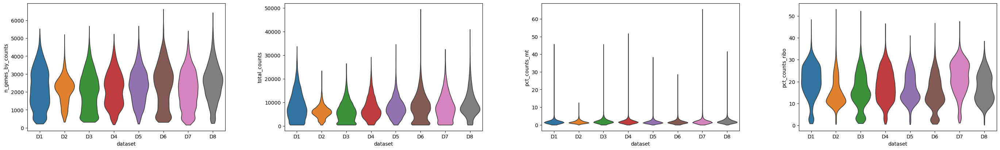

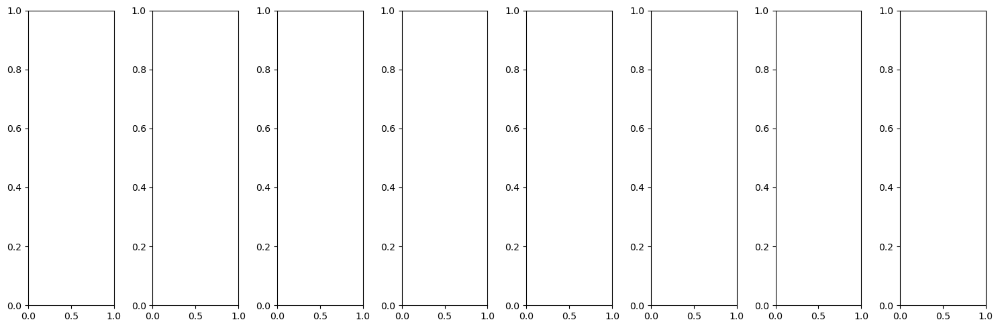

/Users/loganlarlham/Documents/Summer_proj_2024/Notebooks/func_lib.py:195: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax.legend(loc='upper right', bbox_to_anchor=(1.2, 1))
/Users/loganlarlham/Documents/Summer_proj_2024/Notebooks/func_lib.py:195: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax.legend(loc='upper right', bbox_to_anchor=(1.2, 1))
/Users/loganlarlham/Documents/Summer_proj_2024/Notebooks/func_lib.py:195: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax.legend(loc='upper right', bbox_to_anchor=(1.2, 1))
/Users/loganlarlham/Documents/Summer_proj_2024/Notebooks/func_lib.py:195: UserWarning: No artists wi

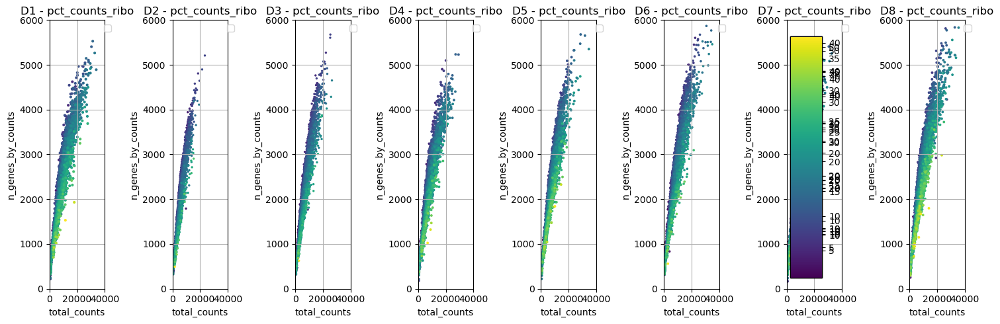

In [13]:
# Visualize pre-filtering QC measures
f.visualize_QC_measures(adatas)

In [14]:
# Basic QC thresholds
QC_filtered_adatas = {}
for adata_key, adata in adatas.items():
    print(f"{adata_key}:")
    QC_filtered_adatas[adata_key] =f.QC_filter_adata(adata, mt_threshold=10, ribo_threshold=5, min_counts=2000, min_genes=300, min_cells=3)
    print("\n")

D1:
Initial AnnData has 3403 cells and 33989 genes
36 of 3403 cells contain more than 10% mitochondrial genes. Will be filtered
197 of 3403 cells contain less than 5% ribosomal genes. Will be filtered
255 of 3184 cells have fewer than 2000 counts. Will be filtered


/opt/homebrew/Caskroom/mambaforge/envs/sc_env3_omni/lib/python3.12/site-packages/scanpy/preprocessing/_simple.py:166: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs["n_counts"] = number


0 of 2929 cells have fewer than 300 genes. Will be filtered
18995 of 33989 genes are expressed in fewer than 3 cells. Will be filtered
Filtered AnnData has 2929 cells and 14994 genes


D2:
Initial AnnData has 5041 cells and 33989 genes
6 of 5041 cells contain more than 10% mitochondrial genes. Will be filtered
85 of 5041 cells contain less than 5% ribosomal genes. Will be filtered
239 of 4954 cells have fewer than 2000 counts. Will be filtered
0 of 4715 cells have fewer than 300 genes. Will be filtered


/opt/homebrew/Caskroom/mambaforge/envs/sc_env3_omni/lib/python3.12/site-packages/scanpy/preprocessing/_simple.py:166: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs["n_counts"] = number


18469 of 33989 genes are expressed in fewer than 3 cells. Will be filtered
Filtered AnnData has 4715 cells and 15520 genes


D3:
Initial AnnData has 5029 cells and 33989 genes
24 of 5029 cells contain more than 10% mitochondrial genes. Will be filtered
616 of 5029 cells contain less than 5% ribosomal genes. Will be filtered
277 of 4405 cells have fewer than 2000 counts. Will be filtered
0 of 4128 cells have fewer than 300 genes. Will be filtered


/opt/homebrew/Caskroom/mambaforge/envs/sc_env3_omni/lib/python3.12/site-packages/scanpy/preprocessing/_simple.py:166: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs["n_counts"] = number


18520 of 33989 genes are expressed in fewer than 3 cells. Will be filtered
Filtered AnnData has 4128 cells and 15469 genes


D4:
Initial AnnData has 3892 cells and 33989 genes
32 of 3892 cells contain more than 10% mitochondrial genes. Will be filtered
131 of 3892 cells contain less than 5% ribosomal genes. Will be filtered
154 of 3745 cells have fewer than 2000 counts. Will be filtered
0 of 3591 cells have fewer than 300 genes. Will be filtered
18928 of 33989 genes are expressed in fewer than 3 cells. Will be filtered


/opt/homebrew/Caskroom/mambaforge/envs/sc_env3_omni/lib/python3.12/site-packages/scanpy/preprocessing/_simple.py:166: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs["n_counts"] = number


Filtered AnnData has 3591 cells and 15061 genes


D5:
Initial AnnData has 3825 cells and 33989 genes
6 of 3825 cells contain more than 10% mitochondrial genes. Will be filtered
71 of 3825 cells contain less than 5% ribosomal genes. Will be filtered
129 of 3750 cells have fewer than 2000 counts. Will be filtered
0 of 3621 cells have fewer than 300 genes. Will be filtered
18728 of 33989 genes are expressed in fewer than 3 cells. Will be filtered


/opt/homebrew/Caskroom/mambaforge/envs/sc_env3_omni/lib/python3.12/site-packages/scanpy/preprocessing/_simple.py:166: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs["n_counts"] = number


Filtered AnnData has 3621 cells and 15261 genes


D6:
Initial AnnData has 4408 cells and 33989 genes
9 of 4408 cells contain more than 10% mitochondrial genes. Will be filtered
498 of 4408 cells contain less than 5% ribosomal genes. Will be filtered
276 of 3904 cells have fewer than 2000 counts. Will be filtered
0 of 3628 cells have fewer than 300 genes. Will be filtered


/opt/homebrew/Caskroom/mambaforge/envs/sc_env3_omni/lib/python3.12/site-packages/scanpy/preprocessing/_simple.py:166: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs["n_counts"] = number


18188 of 33989 genes are expressed in fewer than 3 cells. Will be filtered
Filtered AnnData has 3628 cells and 15801 genes


D7:
Initial AnnData has 3643 cells and 33989 genes
34 of 3643 cells contain more than 10% mitochondrial genes. Will be filtered
121 of 3643 cells contain less than 5% ribosomal genes. Will be filtered
359 of 3497 cells have fewer than 2000 counts. Will be filtered
0 of 3138 cells have fewer than 300 genes. Will be filtered
19047 of 33989 genes are expressed in fewer than 3 cells. Will be filtered
Filtered AnnData has 3138 cells and 14942 genes


/opt/homebrew/Caskroom/mambaforge/envs/sc_env3_omni/lib/python3.12/site-packages/scanpy/preprocessing/_simple.py:166: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs["n_counts"] = number




D8:
Initial AnnData has 3903 cells and 33989 genes
18 of 3903 cells contain more than 10% mitochondrial genes. Will be filtered
34 of 3903 cells contain less than 5% ribosomal genes. Will be filtered
228 of 3863 cells have fewer than 2000 counts. Will be filtered


/opt/homebrew/Caskroom/mambaforge/envs/sc_env3_omni/lib/python3.12/site-packages/scanpy/preprocessing/_simple.py:166: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs["n_counts"] = number


0 of 3635 cells have fewer than 300 genes. Will be filtered
18052 of 33989 genes are expressed in fewer than 3 cells. Will be filtered
Filtered AnnData has 3635 cells and 15937 genes




Visualizations QC Measures for multiple datasets:


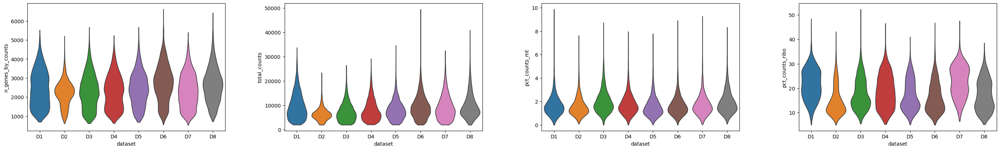

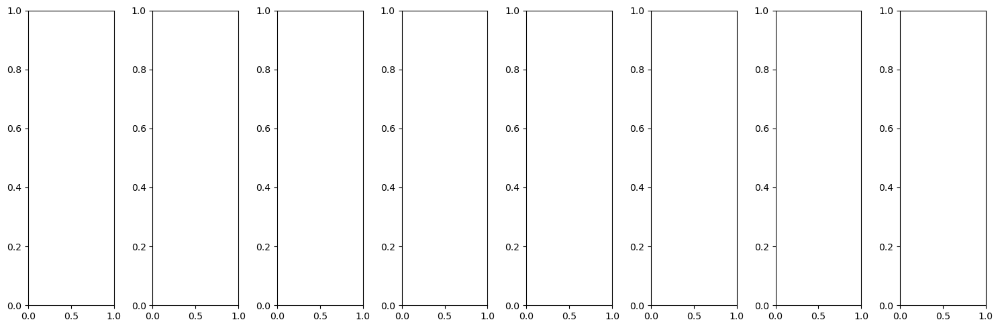

/Users/loganlarlham/Documents/Summer_proj_2024/Notebooks/func_lib.py:195: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax.legend(loc='upper right', bbox_to_anchor=(1.2, 1))
/Users/loganlarlham/Documents/Summer_proj_2024/Notebooks/func_lib.py:195: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax.legend(loc='upper right', bbox_to_anchor=(1.2, 1))
/Users/loganlarlham/Documents/Summer_proj_2024/Notebooks/func_lib.py:195: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax.legend(loc='upper right', bbox_to_anchor=(1.2, 1))
/Users/loganlarlham/Documents/Summer_proj_2024/Notebooks/func_lib.py:195: UserWarning: No artists wi

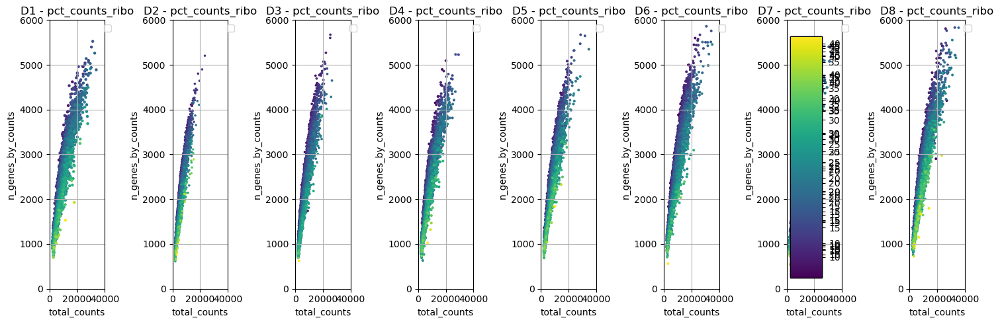

In [15]:
f.visualize_QC_measures(QC_filtered_adatas)

# Remove Non-Microglia (need to add manual annotation step from analysis1 notebook)

In [16]:
# Initialize counters for total cells before and after removal
total_cells_before = 0
total_cells_after = 0

# Loop through each adata in the QC_filtered_adatas dictionary
for i, (adata_key, adata) in enumerate(QC_filtered_adatas.items()):
    print(f"Processing {adata_key}:")

    # Get the cells that are in the adata
    adata_cell_ids = adata.obs.index

    # Add the number of cells in the current adata to the total before removal
    total_cells_before += len(adata_cell_ids)

    # Define the expected suffix based on the current index (e.g., _0 for first, _1 for second)
    expected_suffix = f'_{i}'

    # Filter manual_annotations to include only the cells with the matching suffix
    manual_annotation_cells_with_suffix = manual_annotations[manual_annotations.index.str.endswith(expected_suffix)]

    # Remove the suffix from manual_annotations to match the format in adata_cell_ids
    manual_annotation_cells = manual_annotation_cells_with_suffix.index.str.replace(expected_suffix, '')

    # Find the cells present in both adata and manual_annotations (after suffix removal)
    matching_cells = adata_cell_ids.intersection(manual_annotation_cells)

    # Find cells annotated as 'Other' in the matching manual_annotations
    other_cells = manual_annotation_cells_with_suffix[manual_annotation_cells_with_suffix['manual_annotation'] == 'Other'].index

    # Ensure the 'Other' cells have the suffix properly formatted before removal
    other_cells_no_suffix = other_cells.str.replace(expected_suffix, '')

    # Remove these 'Other' cells from the adata
    print(f"Removing {len(other_cells)} cells annotated as 'Other' from {adata_key}")
    adata = adata[~adata.obs.index.isin(other_cells_no_suffix)].copy()

    # Add the number of cells in the current adata to the total after removal
    total_cells_after += adata.obs.shape[0]

    # Update the adatas dictionary with the filtered adata
    QC_filtered_adatas[adata_key] = adata

    print(f"Number of cells after removal in {adata_key}: {adata.obs.shape[0]}")
    print("\n")

# Print the total cell counts before and after removal
print(f"Total number of cells before removing 'Other' cells: {total_cells_before}")
print(f"Total number of cells after removing 'Other' cells: {total_cells_after}")

Processing D1:
Removing 67 cells annotated as 'Other' from D1
Number of cells after removal in D1: 2866


Processing D2:
Removing 509 cells annotated as 'Other' from D2
Number of cells after removal in D2: 4250


Processing D3:
Removing 387 cells annotated as 'Other' from D3
Number of cells after removal in D3: 3770


Processing D4:
Removing 124 cells annotated as 'Other' from D4
Number of cells after removal in D4: 3472


Processing D5:
Removing 209 cells annotated as 'Other' from D5
Number of cells after removal in D5: 3412


Processing D6:
Removing 207 cells annotated as 'Other' from D6
Number of cells after removal in D6: 3429


Processing D7:
Removing 31 cells annotated as 'Other' from D7
Number of cells after removal in D7: 3107


Processing D8:
Removing 0 cells annotated as 'Other' from D8
Number of cells after removal in D8: 3635


Total number of cells before removing 'Other' cells: 29385
Total number of cells after removing 'Other' cells: 27941


# Merge

In [17]:
adata = ad.concat(list(QC_filtered_adatas.values()), axis=0, label="sample", join="outer", merge="unique")
adata.obs_names_make_unique()

print(adata)

AnnData object with n_obs × n_vars = 27941 × 17355
    obs: 'K231', 'K233', 'K234', 'K219', 'Classification', 'most_likely_hypothesis', 'genotype', 'apoe', 'disease', 'treatment', 'genotype_treatment', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'n_counts', 'n_genes', 'G143', 'G146', 'K232', 'G180', 'K257', 'K261', 'K262', 'K268', 'G118', 'G119', 'G120', 'G122', 'G183', 'G184', 'G185', 'G186', 'K248', 'K249', 'K250', 'K252', 'G177', 'G178', 'G179', 'G145', 'K283', 'K284', 'sample'


/opt/homebrew/Caskroom/mambaforge/envs/sc_env3_omni/lib/python3.12/site-packages/anndata/_core/anndata.py:1756: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


In [18]:

# remove and gc the QC_filtered_adatas and adatas
del QC_filtered_adatas
del adatas
gc.collect()

57785

# Make Subsets for Experimental Conditions

In [19]:
adata.obs

,K231,K233,K234,K219,Classification,most_likely_hypothesis,genotype,apoe,disease,treatment,...,K249,K250,K252,G177,G178,G179,G145,K283,K284,sample
AAACCCACACACCTAA-1,5.0,6.0,1.0,339.0,K219,1.0,E4FAD,E4,FAD,LPS,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0
AAACCCACACTGTGTA-1,5.0,4.0,5.0,313.0,K219,1.0,E4FAD,E4,FAD,LPS,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0
AAACGAATCATTCCTA-1,3.0,6.0,283.0,7.0,K234,1.0,E3FAD,E3,FAD,VEHICLE,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0
AAACGCTAGACGCCAA-1,97.0,3.0,7.0,1.0,K231,1.0,E3FAD,E3,FAD,VEHICLE,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0
AAACGCTAGCCAAGGT-1,2.0,4.0,162.0,3.0,K234,1.0,E3FAD,E3,FAD,VEHICLE,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGTTGAGGGTTAAT-1,NaN,NaN,NaN,NaN,K283,1.0,E3WT,E3,WT,LPS,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,455.0,1.0,7
TTTGTTGCATTGGATC-1,NaN,NaN,NaN,NaN,K283,1.0,E3WT,E3,WT,LPS,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,490.0,0.0,7
TTTGTTGGTACGGATG-1,NaN,NaN,NaN,NaN,K283,1.0,E3WT,E3,WT,LPS,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,540.0,4.0,7
TTTGTTGGTTCGTAAC-1,NaN,NaN,NaN,NaN,K283,1.0,E3WT,E3,WT,LPS,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,998.0,1.0,7


In [20]:
adata.uns['name'] = 'Full Dataset (All Samples, only Microglia, MT-regressed, QC-filtered)'

# Now create subsets for each genotype
adata_e3fad = adata[adata.obs['genotype'] == 'E3FAD'].copy()
adata_e3fad.uns['name'] = 'E3FAD'
adata_e4fad = adata[adata.obs['genotype'] == 'E4FAD'].copy()
adata_e4fad.uns['name'] = 'E4FAD'
adata_e3wt = adata[adata.obs['genotype'] == 'E3WT'].copy()
adata_e3wt.uns['name'] = 'E3WT'
adata_e4wt = adata[adata.obs['genotype'] == 'E4WT'].copy()
adata_e4wt.uns['name'] = 'E4WT'
# Now subset for each specific genotype and treatment
adata_e3fad_lps = adata_e3fad[adata_e3fad.obs['treatment'] == 'LPS'].copy()
adata_e3fad_lps.uns['name'] = 'E3FAD_LPS'
adata_e3fad_vehicle = adata_e3fad[adata_e3fad.obs['treatment'] == 'VEHICLE'].copy()
adata_e3fad_vehicle.uns['name'] = 'E3FAD_VEHICLE'
adata_e4fad_lps = adata_e4fad[adata_e4fad.obs['treatment'] == 'LPS'].copy()
adata_e4fad_lps.uns['name'] = 'E4FAD_LPS'
adata_e4fad_vehicle = adata_e4fad[adata_e4fad.obs['treatment'] == 'VEHICLE'].copy()
adata_e4fad_vehicle.uns['name'] = 'E4FAD_VEHICLE'
adata_e3wt_lps = adata_e3wt[adata_e3wt.obs['treatment'] == 'LPS'].copy()
adata_e3wt_lps.uns['name'] = 'E3WT_LPS'
adata_e3wt_vehicle = adata_e3wt[adata_e3wt.obs['treatment'] == 'VEHICLE'].copy()
adata_e3wt_vehicle.uns['name'] = 'E3WT_VEHICLE'
adata_e4wt_lps = adata_e4wt[adata_e4wt.obs['treatment'] == 'LPS'].copy()
adata_e4wt_lps.uns['name'] = 'E4WT_LPS'
adata_e4wt_vehicle = adata_e4wt[adata_e4wt.obs['treatment'] == 'VEHICLE'].copy()
adata_e4wt_vehicle.uns['name'] = 'E4WT_VEHICLE'
# Also creat subset for 'apoe' and 'treatment
adata_e4 = adata[adata.obs['apoe'] == 'E4'].copy()
adata_e4.uns['name'] = 'E4'
adata_e3 = adata[adata.obs['apoe'] == 'E3'].copy()
adata_e3.uns['name'] = 'E3'
adata_e4_lps = adata_e4[adata_e4.obs['treatment'] == 'LPS'].copy()
adata_e4_lps.uns['name'] = 'E4_LPS'
adata_e4_vehicle = adata_e4[adata_e4.obs['treatment'] == 'VEHICLE'].copy()
adata_e4_vehicle.uns['name'] = 'E4_VEHICLE'
adata_e3_lps = adata_e3[adata_e3.obs['treatment'] == 'LPS'].copy()
adata_e3_lps.uns['name'] = 'E3_LPS'
adata_e3_vehicle = adata_e3[adata_e3.obs['treatment'] == 'VEHICLE'].copy()
adata_e3_vehicle.uns['name'] = 'E3_VEHICLE'





adata_subs = [adata_e4, adata_e3, adata_e4_lps, adata_e4_vehicle, adata_e3_lps, adata_e3_vehicle, adata_e3fad, adata_e4fad, adata_e3wt, adata_e4wt, adata_e3fad_lps, adata_e3fad_vehicle, adata_e4fad_lps, adata_e4fad_vehicle, adata_e3wt_lps, adata_e3wt_vehicle, adata_e4wt_lps, adata_e4wt_vehicle]
print(adata_subs)
print(adata)

[AnnData object with n_obs × n_vars = 13927 × 17355
    obs: 'K231', 'K233', 'K234', 'K219', 'Classification', 'most_likely_hypothesis', 'genotype', 'apoe', 'disease', 'treatment', 'genotype_treatment', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'n_counts', 'n_genes', 'G143', 'G146', 'K232', 'G180', 'K257', 'K261', 'K262', 'K268', 'G118', 'G119', 'G120', 'G122', 'G183', 'G184', 'G185', 'G186', 'K248', 'K249', 'K250', 'K252', 'G177', 'G178', 'G179', 'G145', 'K283', 'K284', 'sample'
    uns: 'name', AnnData object with n_obs × n_vars = 14014 × 17355
    obs: 'K231', 'K233', 'K234', 'K219', 'Classification', 'most_likely_hypothesis', 'genotype', 'apoe', 'disease', 'treatment', 'genotype_treatment', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'n_counts', 'n_genes', 'G143', 'G146', 'K232', 'G180', 'K257', 'K261', 'K262', 'K268', 'G118', 'G119', 'G120', '

# Normalize and HVG

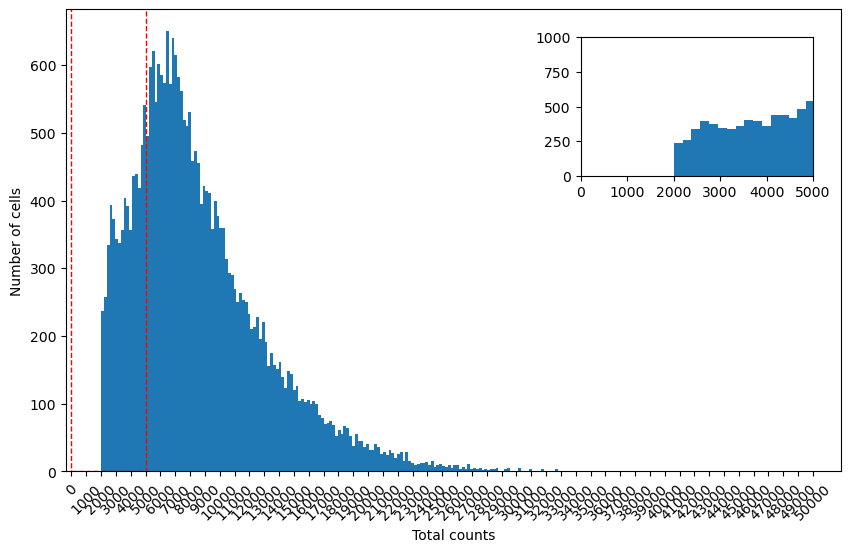

In [21]:
# before normalizing, save the raw counts
adata.layers["counts"] = adata.X.copy()
f.plot_total_counts_vs_cells(adata, bins=250, zoom_x_range=(0, 5000), zoom_y_range=(0, 1000))
#  same for the subsets
for adata_sub in adata_subs:
    adata_sub.layers["counts"] = adata_sub.X.copy()

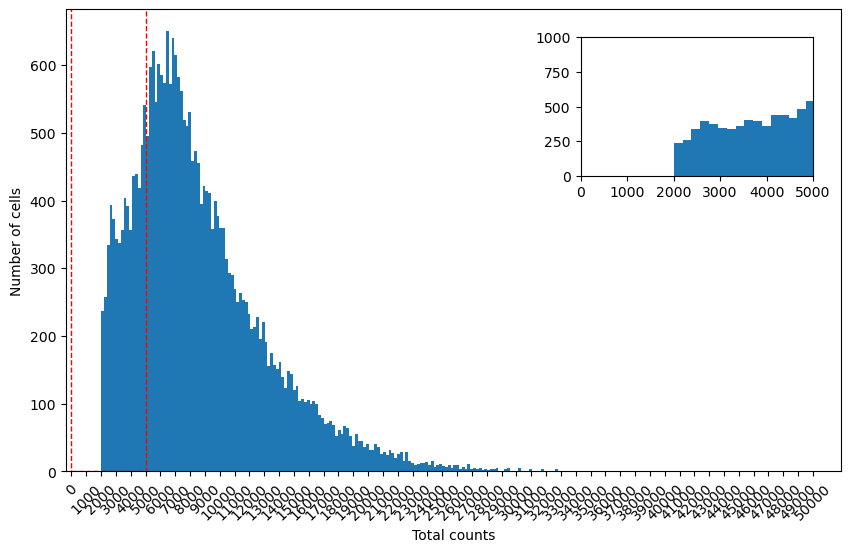

In [22]:
# normalize and log the data and store that in a different layer too incase we need to switch between them.
sc.pp.normalize_total(adata)
sc.pp.log1p(adata)
adata.layers['log_norm'] = adata.X.copy()
#so we can plot a histogram of the total counts/cells after norm
adata.obs["norm_total_counts"] = adata.X.sum(axis=1)    
f.plot_total_counts_vs_cells(adata, bins=250, zoom_x_range=(0, 5000), zoom_y_range=(0, 1000))

#  same for the subsets (without plot)      
for adata_sub in adata_subs:
    sc.pp.normalize_total(adata_sub)
    sc.pp.log1p(adata_sub)
    adata_sub.layers['log_norm'] = adata_sub.X.copy()

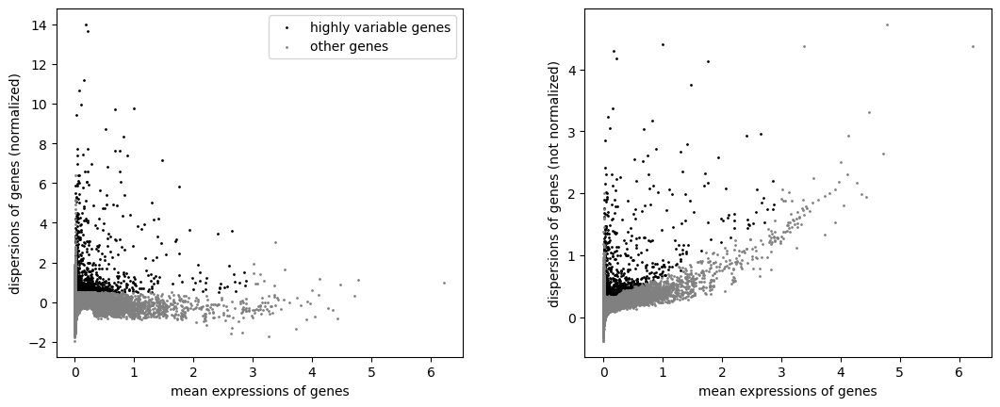

1109 out of 17355 genes are considered highly variable.
1109 out of 17355 genes are considered highly variable.
1109 out of 17355 genes are considered highly variable.
1109 out of 17355 genes are considered highly variable.
1109 out of 17355 genes are considered highly variable.
1109 out of 17355 genes are considered highly variable.
1109 out of 17355 genes are considered highly variable.
1109 out of 17355 genes are considered highly variable.
1109 out of 17355 genes are considered highly variable.
1109 out of 17355 genes are considered highly variable.
1109 out of 17355 genes are considered highly variable.
1109 out of 17355 genes are considered highly variable.
1109 out of 17355 genes are considered highly variable.
1109 out of 17355 genes are considered highly variable.
1109 out of 17355 genes are considered highly variable.
1109 out of 17355 genes are considered highly variable.
1109 out of 17355 genes are considered highly variable.
1109 out of 17355 genes are considered highly va

In [23]:
sc.pp.highly_variable_genes(adata, batch_key="sample")
sc.pl.highly_variable_genes(adata)
#make some variables to print a nice little summary
num_highly_variable_genes_t = adata.var['highly_variable'].sum()
total_genes_t = adata.var.shape[0]

print(f"{num_highly_variable_genes_t} out of {total_genes_t} genes are considered highly variable.")

#  same for the subsets
for adata_sub in adata_subs:
    sc.pp.highly_variable_genes(adata_sub, batch_key="sample")
    num_highly_variable_genes_t = adata.var['highly_variable'].sum()
    total_genes_t = adata.var.shape[0]

    print(f"{num_highly_variable_genes_t} out of {total_genes_t} genes are considered highly variable.")   

# Cell Cycle Analysis

In [24]:
adata.X = adata.layers["counts"].copy()
adata=f.annotate_cellcycle_mouse(adata)

df = adata.obs[['phase', 'genotype', 'apoe', 'treatment', 'disease']]


# Calculate and print the total percentages for each phase
total_phase_percentages = {}
total_count = adata.obs.shape[0]

for p in adata.obs['phase'].unique():
    phase_count = len(adata.obs[adata.obs['phase'] == p])
    phase_percentage = round(phase_count / total_count * 100, 2)
    total_phase_percentages[p] = phase_percentage
    print(f"The percent of {p} phase in the total dataset is {phase_percentage}%")
print("\n")

# Calculate and print the percentages for each sample and compare to the total dataset
for s in adata.obs['sample'].unique():
    for p in adata.obs['phase'].unique():
        phase_count = adata[(adata.obs['phase'] == p) & (adata.obs['sample'] == s)].shape[0]
        sample_total_count = adata[adata.obs['sample'] == s].shape[0]
        sample_phase_percentage = round(phase_count / sample_total_count * 100, 2)
        total_phase_percentage = total_phase_percentages[p]
        difference = sample_phase_percentage - total_phase_percentage
        difference_statement = f"{difference:.2f}% higher" if difference > 0 else f"{-difference:.2f}% lower"
        print(f"{s} : The percent of {p} phase is {sample_phase_percentage}% ({difference_statement} than the total dataset)")
    print('\n')


for s in adata.obs['genotype'].dropna().unique():
    for p in adata.obs['phase'].unique():
        phase_count = adata[(adata.obs['phase'] == p) & (adata.obs['genotype'] == s)].shape[0]
        sample_total_count = adata[adata.obs['genotype'] == s].shape[0]
        sample_phase_percentage = round(phase_count / sample_total_count * 100, 2)
        total_phase_percentage = total_phase_percentages[p]
        difference = sample_phase_percentage - total_phase_percentage
        difference_statement = f"{difference:.2f}% higher" if difference > 0 else f"{-difference:.2f}% lower"
        print(f"{s} : The percent of {p} phase is {sample_phase_percentage}% ({difference_statement} than the total dataset)")
    print('\n')

       'Kif20B', 'Hn1', 'Cdc25C', 'Kif2C', 'G2E3', 'Gas2L3'],
      dtype='object')
The percent of S phase in the total dataset is 27.26%
The percent of G1 phase in the total dataset is 66.34%
The percent of G2M phase in the total dataset is 6.4%


0 : The percent of S phase is 30.77% (3.51% higher than the total dataset)
0 : The percent of G1 phase is 63.54% (2.80% lower than the total dataset)
0 : The percent of G2M phase is 5.69% (0.71% lower than the total dataset)


1 : The percent of S phase is 24.85% (2.41% lower than the total dataset)
1 : The percent of G1 phase is 68.68% (2.34% higher than the total dataset)
1 : The percent of G2M phase is 6.47% (0.07% higher than the total dataset)


2 : The percent of S phase is 26.74% (0.52% lower than the total dataset)
2 : The percent of G1 phase is 66.37% (0.03% higher than the total dataset)
2 : The percent of G2M phase is 6.9% (0.50% higher than the total dataset)


3 : The percent of S phase is 28.2% (0.94% higher than the total data

# Regress Mitochondrial genes

In [25]:
adata.X = adata.layers['log_norm'].copy()

#  same for the subsets
for adata_sub in adata_subs:
    adata_sub.X = adata_sub.layers['log_norm'].copy()

In [26]:

adata = sc.pp.regress_out(adata, 'pct_counts_mt', copy=True)

#  same for the subsets
for adata_sub in adata_subs:
    adata_sub = sc.pp.regress_out(adata_sub, 'pct_counts_mt', copy=True)
    


# Dimensionality Reduction

In [27]:
# Prior to various plots, Lets the levels of the categorical variable 'genotype_treatment' in the dataset so it is ordered correctly in the plots
adata.obs['genotype_treatment'] = pd.Categorical(adata.obs['genotype_treatment'], categories=['E3WT_VEHICLE', 'E3WT_LPS', 'E3FAD_VEHICLE', 'E3FAD_LPS', 'E4WT_VEHICLE', 'E4WT_LPS', 'E4FAD_VEHICLE', 'E4FAD_LPS'], ordered=True)

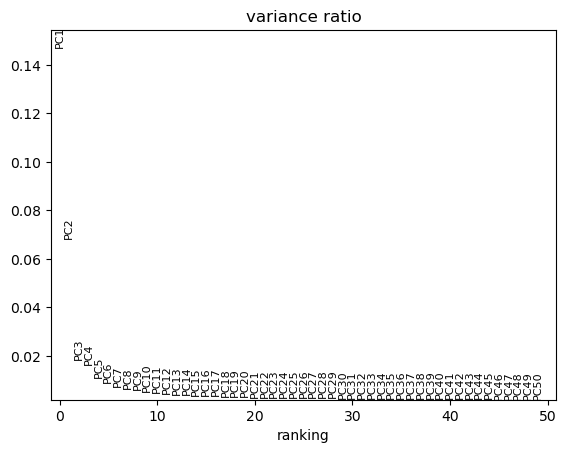

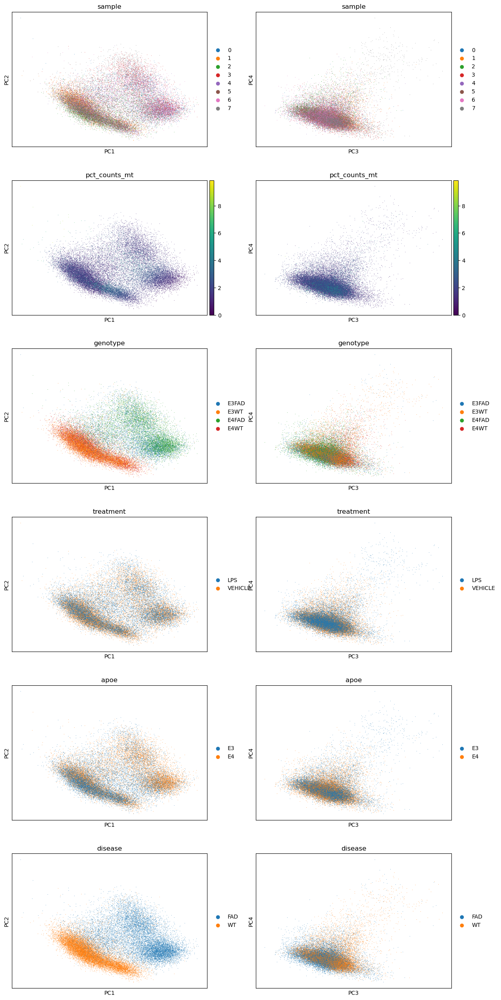

In [28]:

sc.tl.pca(adata)
sc.pl.pca_variance_ratio(adata, n_pcs=50)

sc.pl.pca(
    adata,
    color=[
        "sample", "sample", "pct_counts_mt", "pct_counts_mt", 
        "genotype", "genotype", "treatment", "treatment", 
        "apoe", "apoe", "disease", "disease"
    ],
    dimensions=[
        (0, 1), (2, 3), (0, 1), (2, 3), 
        (0, 1), (2, 3), (0, 1), (2, 3), 
        (0, 1), (2, 3), (0, 1), (2, 3)
    ],
    ncols=2,
    size=2
)

#  same for the subsets (without plot)
for adata_sub in adata_subs:
    sc.tl.pca(adata_sub)

In [29]:
sc.pp.neighbors(adata, n_pcs=25)

sc.tl.umap(adata, min_dist=0.5)


# same for the subsets
for adata_sub in adata_subs:
    sc.pp.neighbors(adata_sub, n_pcs=25)
    sc.tl.umap(adata_sub)


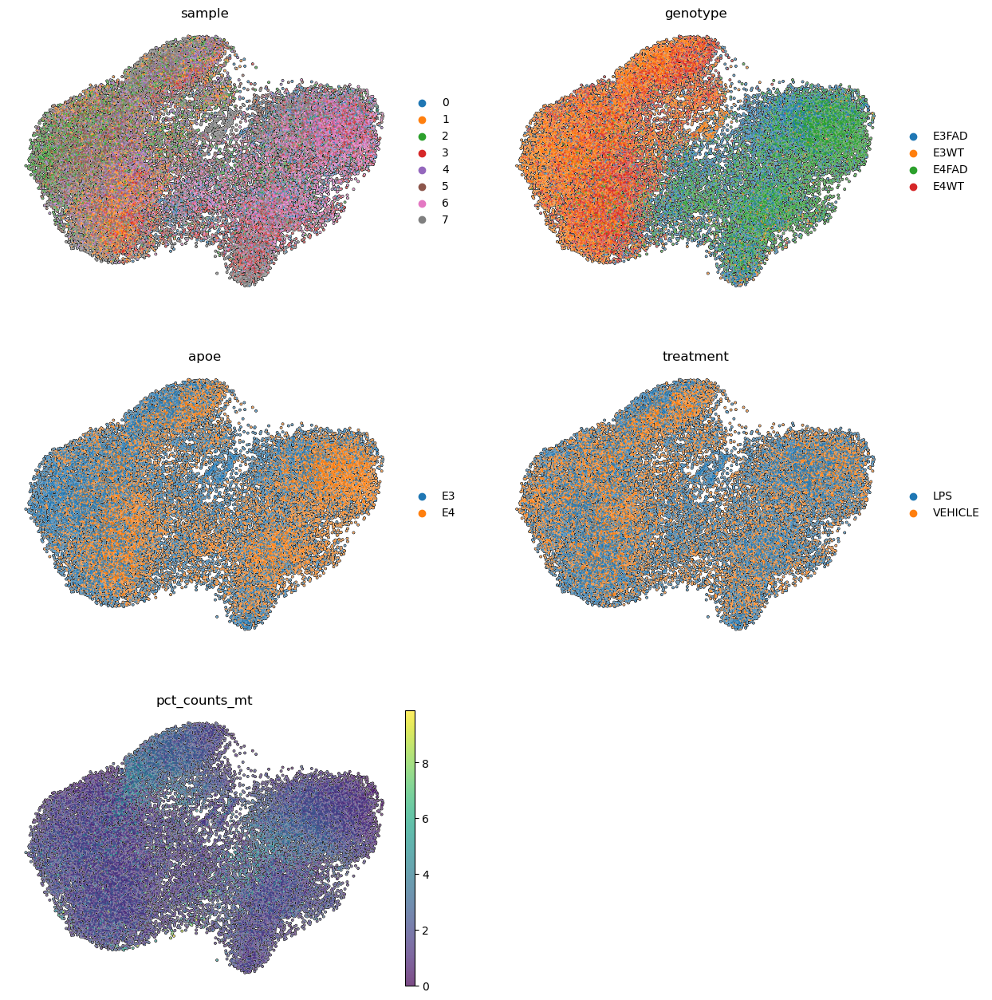

In [30]:
sc.pl.umap(adata, color=['sample','genotype', 'apoe', 'treatment', 'pct_counts_mt'], size =10, ncols=2,  frameon=False, add_outline=True)

In [31]:
sc.tl.umap(adata, min_dist=0.5, n_components=3)


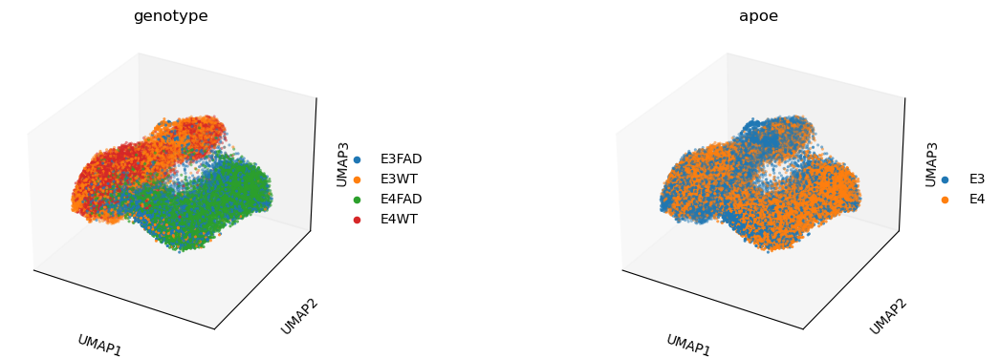

In [32]:
sc.pl.umap(adata, color=['genotype', 'apoe'], size=15,  add_outline=True, projection='3d')

# Cluster

In [33]:
i = 0.1
while i <= 1.9:
    key = f"leiden_{i}"
    if key not in adata.obs:
        sc.tl.leiden(
            adata,
            resolution=i,
            random_state=0,
            n_iterations=2,
            directed=False,
            key_added=key,
            flavor="igraph"
        )
    i += 0.2
    i = round(i, 2)


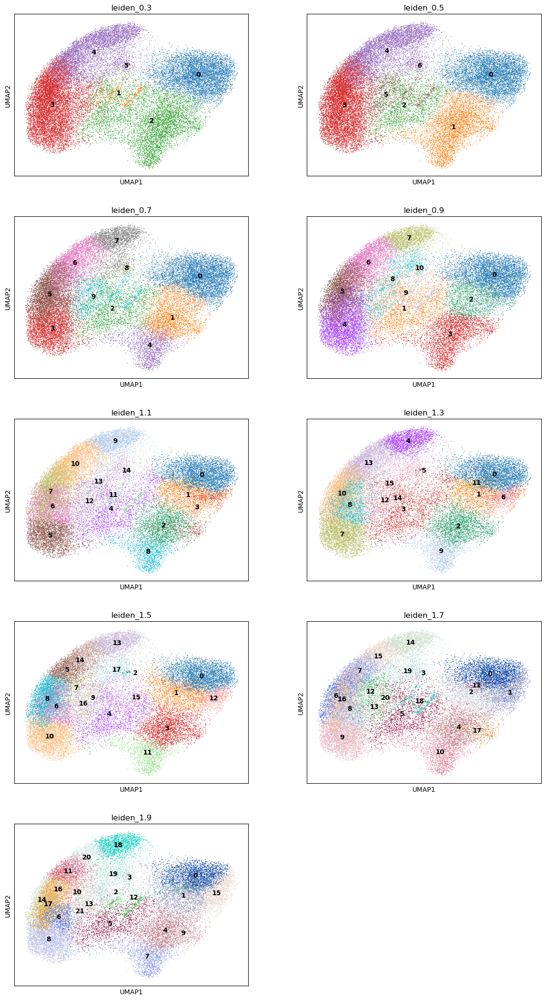

In [34]:


sc.pl.umap(adata, color=['leiden_0.3', 'leiden_0.5', 'leiden_0.7', 'leiden_0.9', 'leiden_1.1', 'leiden_1.3', 'leiden_1.5', 'leiden_1.7', 'leiden_1.9'], legend_loc="on data", ncols=2)


Plotting UMAP for E4:


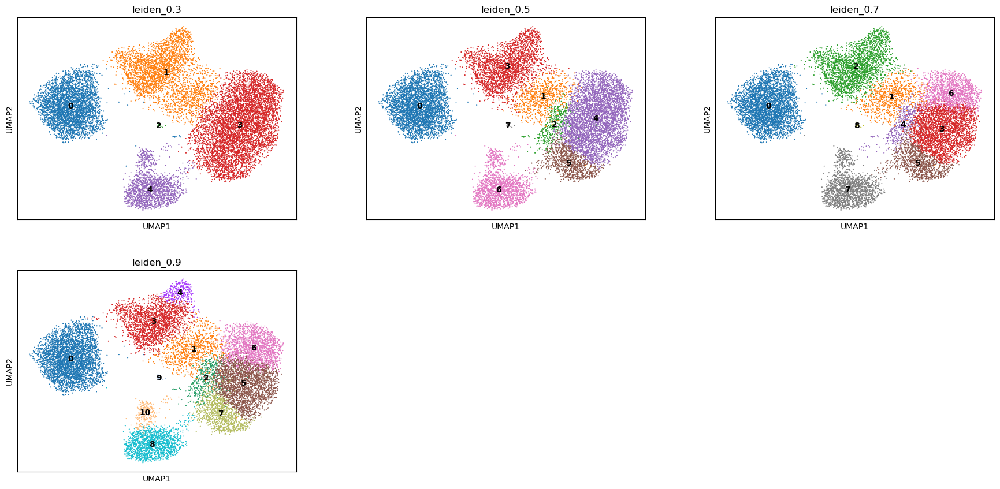

Plotting UMAP for E3:


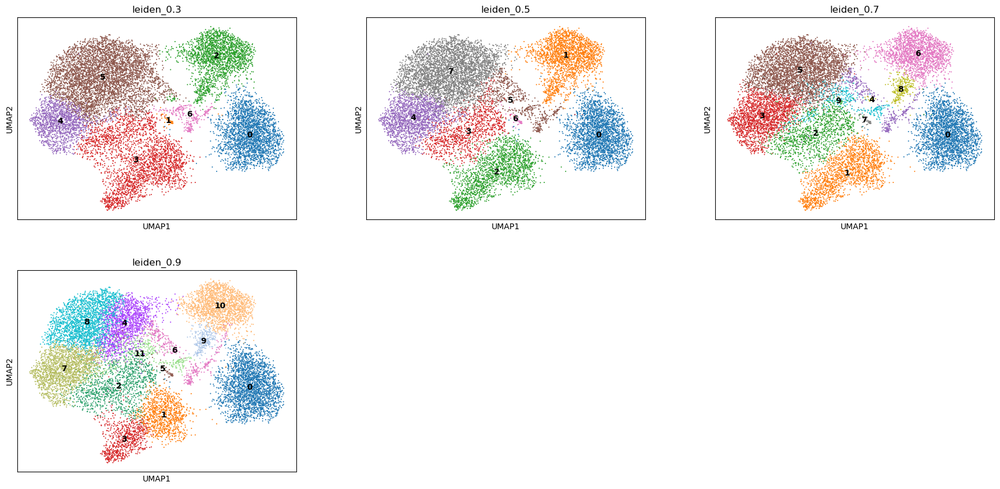

Plotting UMAP for E4_LPS:


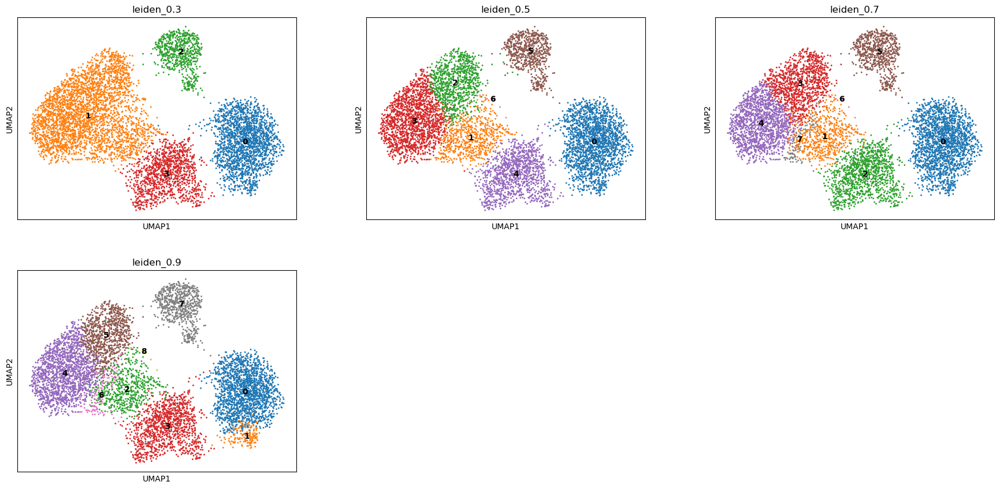

Plotting UMAP for E4_VEHICLE:


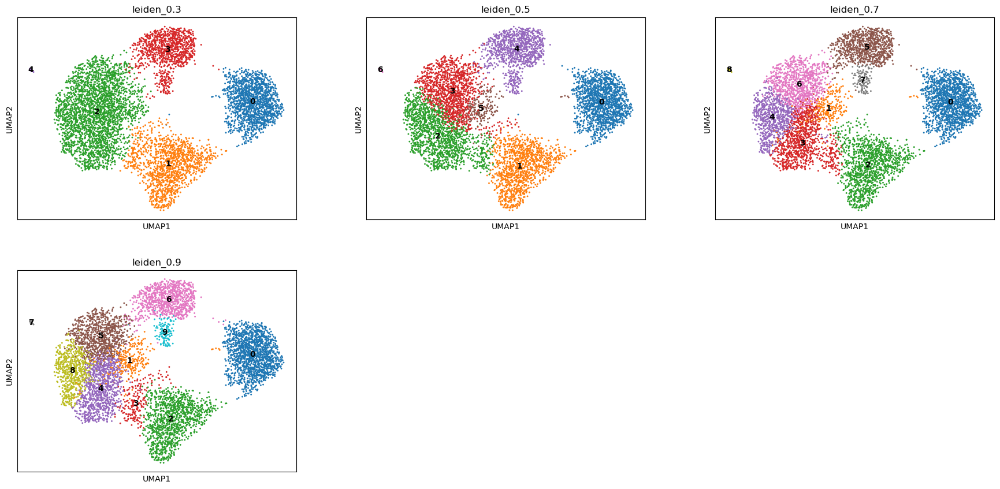

Plotting UMAP for E3_LPS:


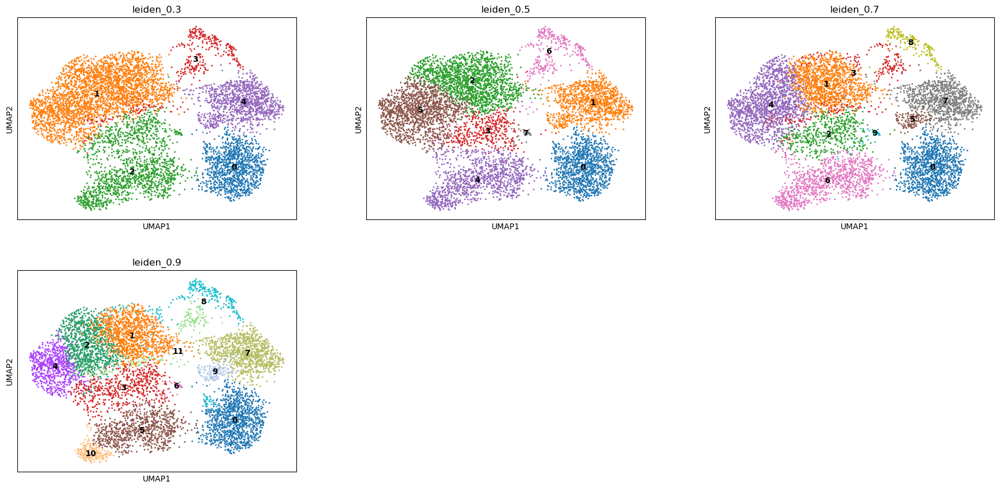

Plotting UMAP for E3_VEHICLE:


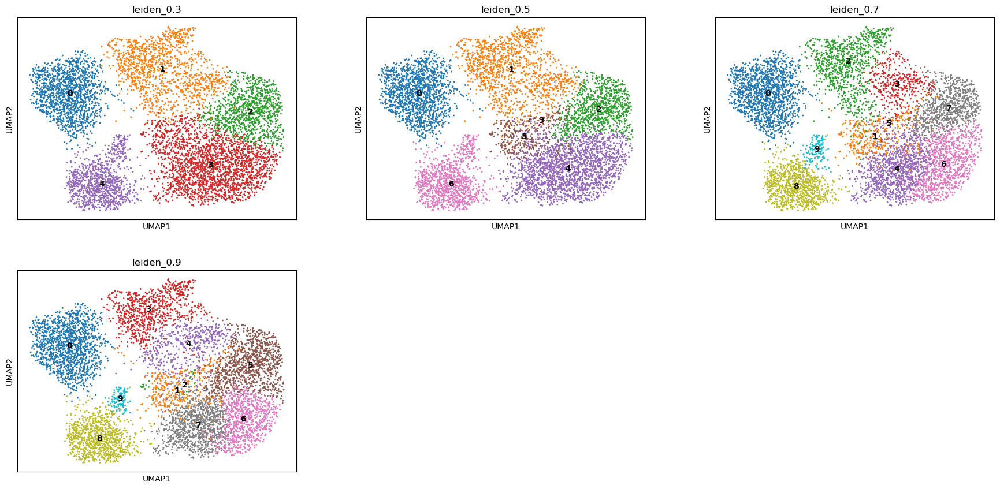

Plotting UMAP for E3FAD:


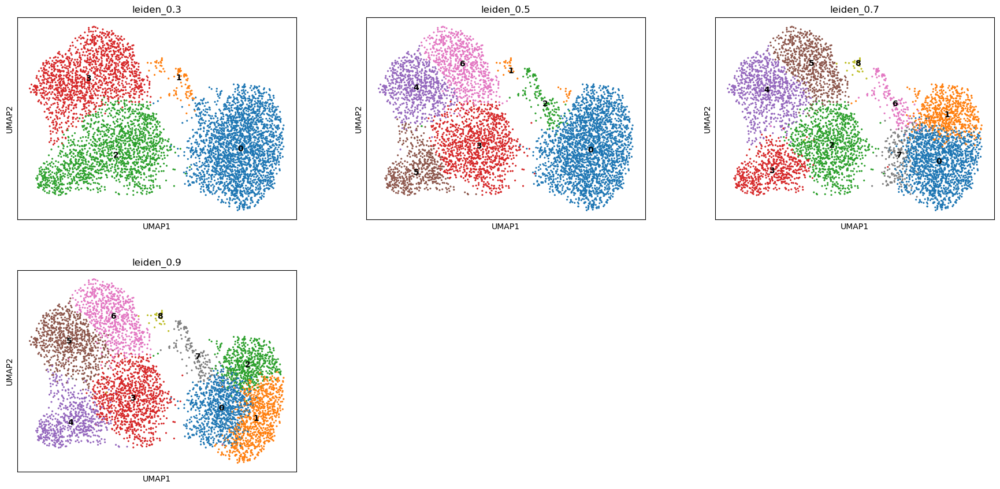

Plotting UMAP for E4FAD:


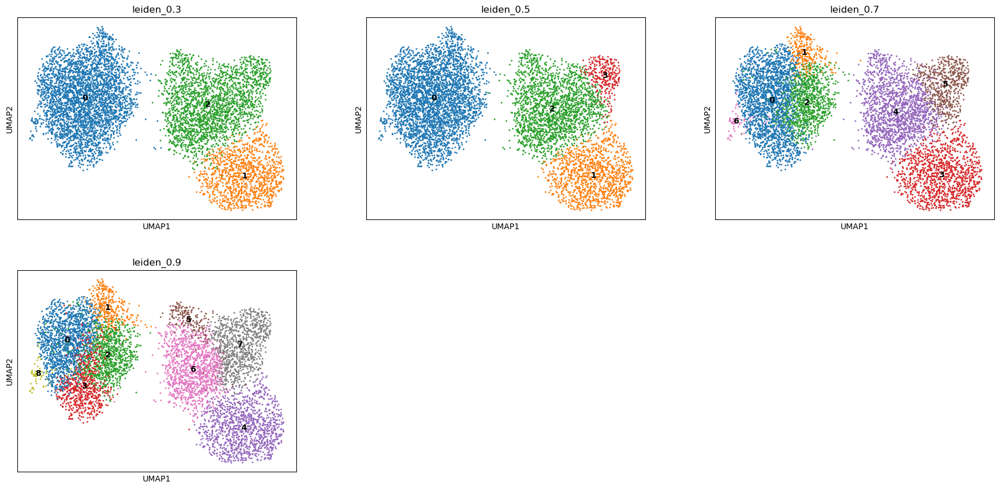

Plotting UMAP for E3WT:


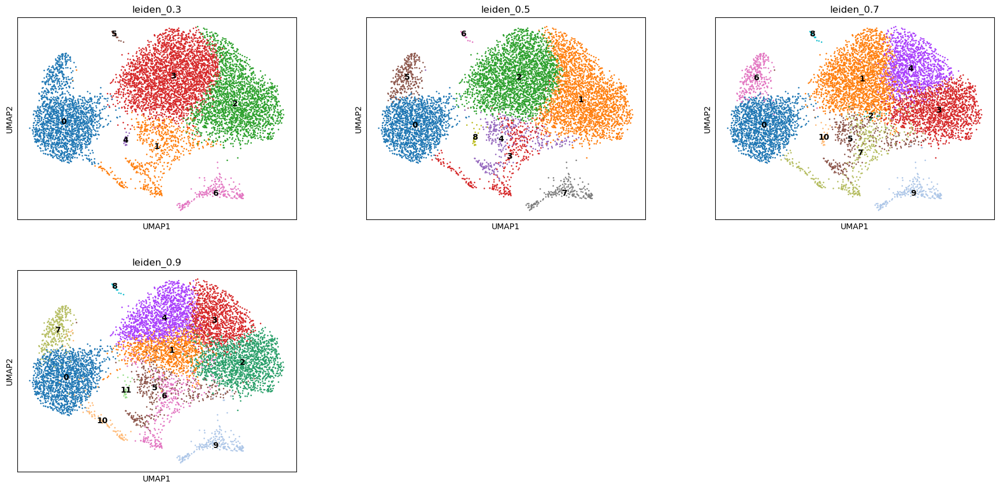

Plotting UMAP for E4WT:


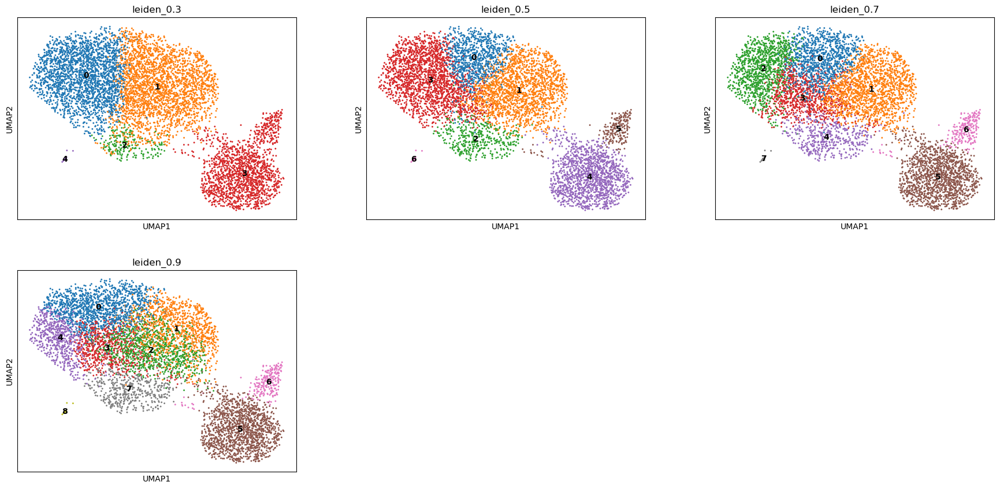

Plotting UMAP for E3FAD_LPS:


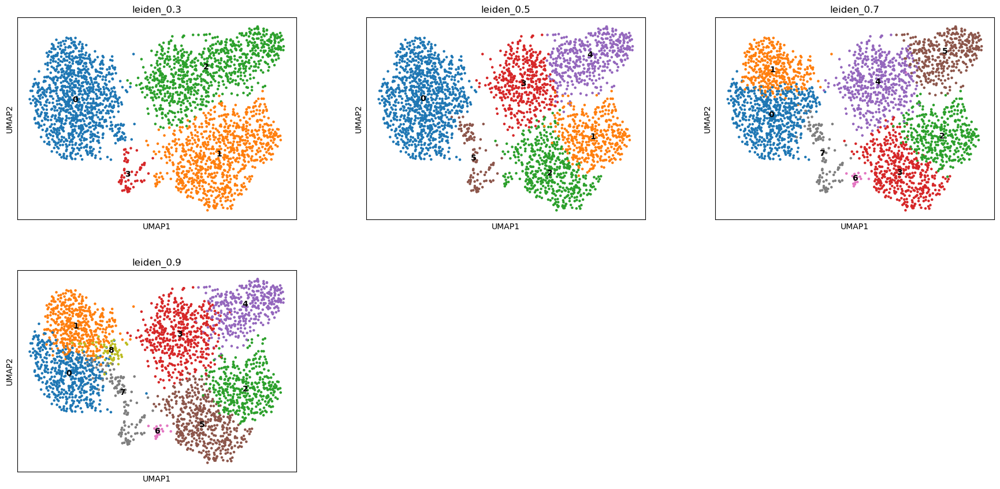

Plotting UMAP for E3FAD_VEHICLE:


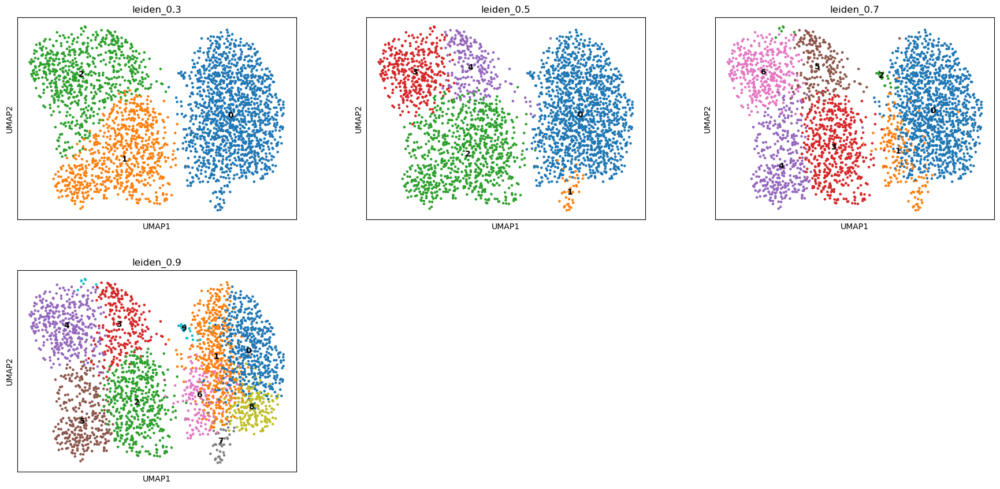

Plotting UMAP for E4FAD_LPS:


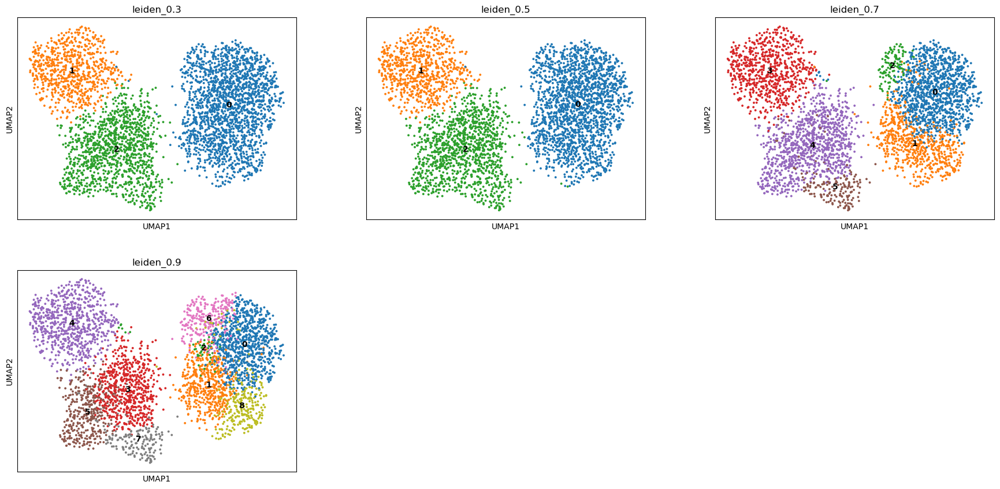

Plotting UMAP for E4FAD_VEHICLE:


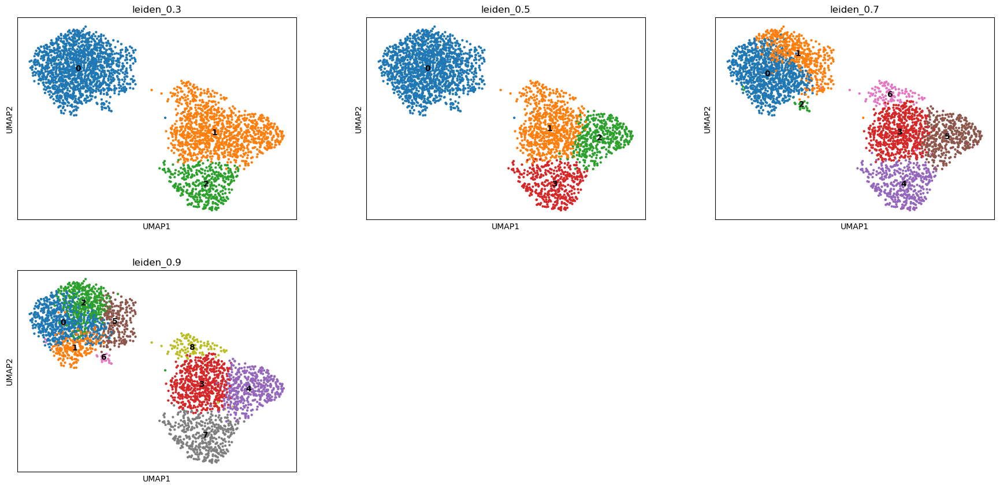

Plotting UMAP for E3WT_LPS:


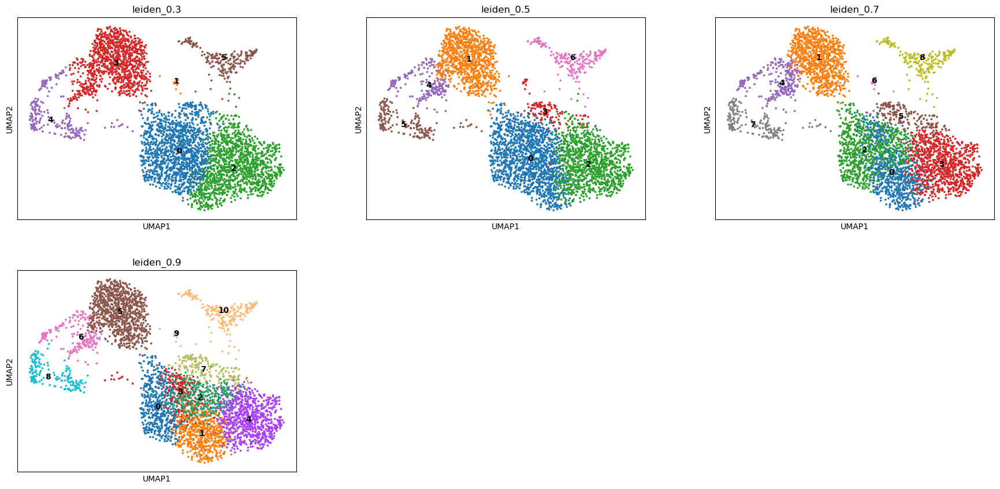

Plotting UMAP for E3WT_VEHICLE:


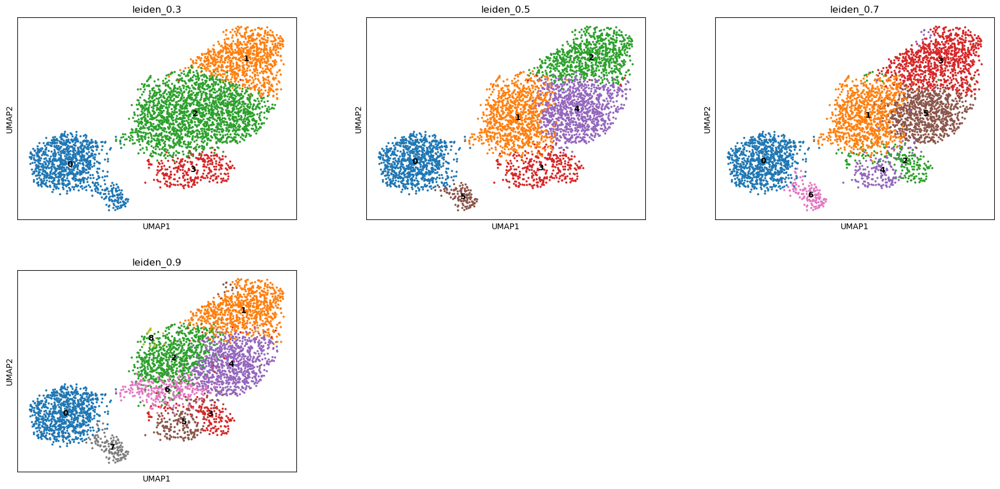

Plotting UMAP for E4WT_LPS:


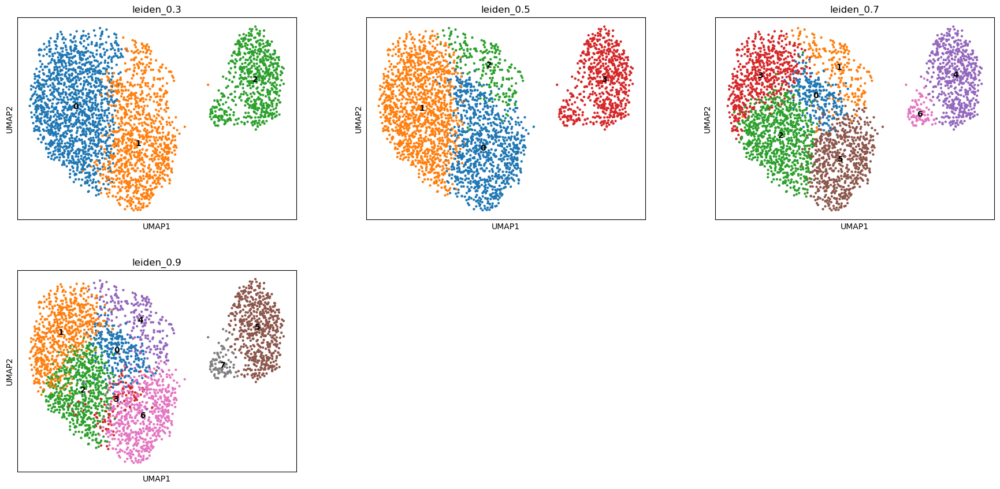

Plotting UMAP for E4WT_VEHICLE:


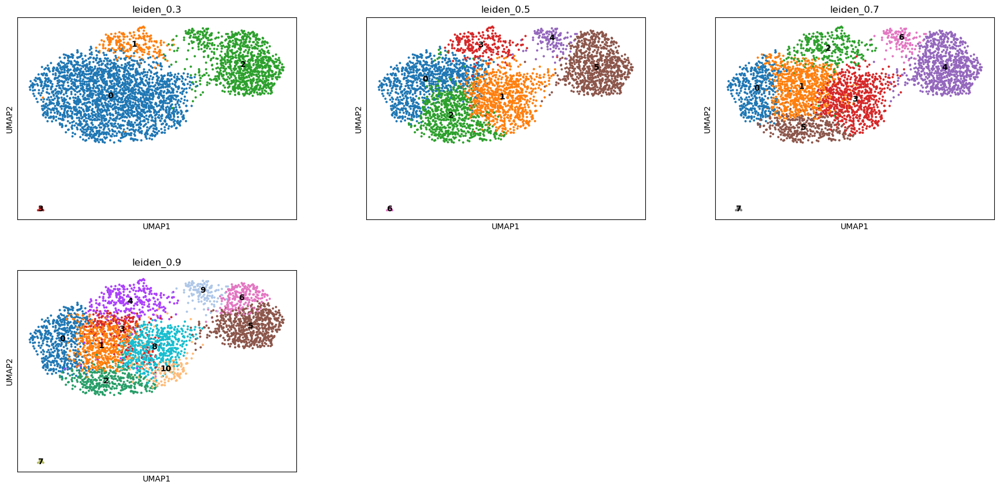

In [35]:


# same for the subsets
for adata_sub in adata_subs:
    i = 0.1
    while i <= 1.3:
        key = f"leiden_{i}"
        if key not in adata_sub.obs:
            sc.tl.leiden(
                adata_sub,
                resolution=i,
                random_state=0,
                n_iterations=2,
                directed=False,
                key_added=key,
                flavor="igraph"
            )
        i += 0.2
        i = round(i, 2)


for adata_sub in adata_subs:
    print(f"Plotting UMAP for {adata_sub.uns['name']}:")
    sc.pl.umap(adata_sub, color=['leiden_0.3', 'leiden_0.5', 'leiden_0.7', 'leiden_0.9'], legend_loc="on data", ncols=3)



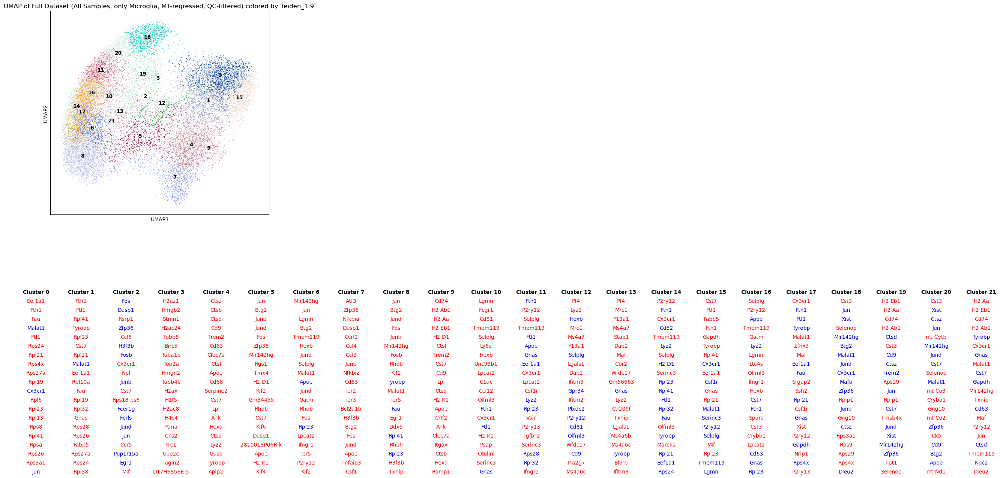

In [36]:
# plot with DEGs by cluster
f.plot_umap_with_gene_list(adata, 'leiden_1.9', n_top_genes=20)

# Assign Cell types 

In [37]:
def assign_cell_types2(adata):
    # Assign tentative cell type labels in adata.obs called ['anno2'] based on the top genes
    # Initialize the 'anno2' column with empty strings or any default value
    adata.obs['anno2'] = ''

    # Assign 'DAM' to cells where 'leiden_1.9' equals 4
    adata.obs.loc[adata.obs['leiden_1.9'].isin(['0','4']) , 'anno2'] = 'Ribosomal with DAM markers'

    # Assign 'Homeostatic' to cells where 'leiden_1.9' equals 7
    adata.obs.loc[adata.obs['leiden_1.9'].isin(['1','6','7']), 'anno2'] = 'DAM'

    # Assign 'G2M/Cdk1+' to cells where 'leiden_1.9' equals 8
    # adata.obs.loc[adata.obs['leiden_1.9'].isin(['2','3']), 'anno2'] = 'Interferon Response'

    # Assign 'IEG-enriched Homeostatic' to cells where 'leiden_1.9' equals 5
    adata.obs.loc[adata.obs['leiden_1.9'].isin(['5']), 'anno2'] = 'Cycling (G2M/Cdk1+)'

    # Assign  'IEG-enriched DAM' to cells where 'leiden_1.9' equals 2
    adata.obs.loc[adata.obs['leiden_1.9'].isin(['8', '10', '18']), 'anno2'] = 'TIM/tCRM/ (Fos/Jun) '

    # Assign 'MHC-II Expressing' to cells where 'leiden_1.9' equals 6
    adata.obs.loc[adata.obs['leiden_1.9'].isin(['2','3','9','15','16','17','22','23']), 'anno2'] = 'Homeostatic'

    # ign 'High Ribosomal DAM' to cells where 'leiden_1.9' equals 0
    adata.obs.loc[adata.obs['leiden_1.9'].isin(['11']), 'anno2'] = 'Cytokine Response'

    # Assing 'High Ribosomal Homeostatic' to cells where 'leiden_1.9' equals 3
    adata.obs.loc[adata.obs['leiden_1.9'].isin(['12']), 'anno2'] = 'MHC-II/Antigen Presentation DAM'

    # Assign 'BAM-like' to cells where 'leiden_1.9' equals 1
    adata.obs.loc[adata.obs['leiden_1.9'].isin(['14', '19']), 'anno2'] = 'BAM-like'

    # adata.obs.loc[adata.obs['leiden_1.9'].isin(['15']), 'anno2'] = 'MHC-II/Antigen Presentation Homeostatic'

    adata.obs.loc[adata.obs['leiden_1.9'].isin(['13', '20']), 'anno2'] = 'Neuronal Surveillance/Ribosomal biogenesis'
    
    adata.obs.loc[adata.obs['leiden_1.9'].isin(['21']), 'anno2'] = 'BAM-like'


    # Assign 'Unknown' to cells where 'anno2' is still empty
    adata.obs.loc[adata.obs['anno2'] == '', 'anno2'] = 'Unknown'

assign_cell_types2(adata)

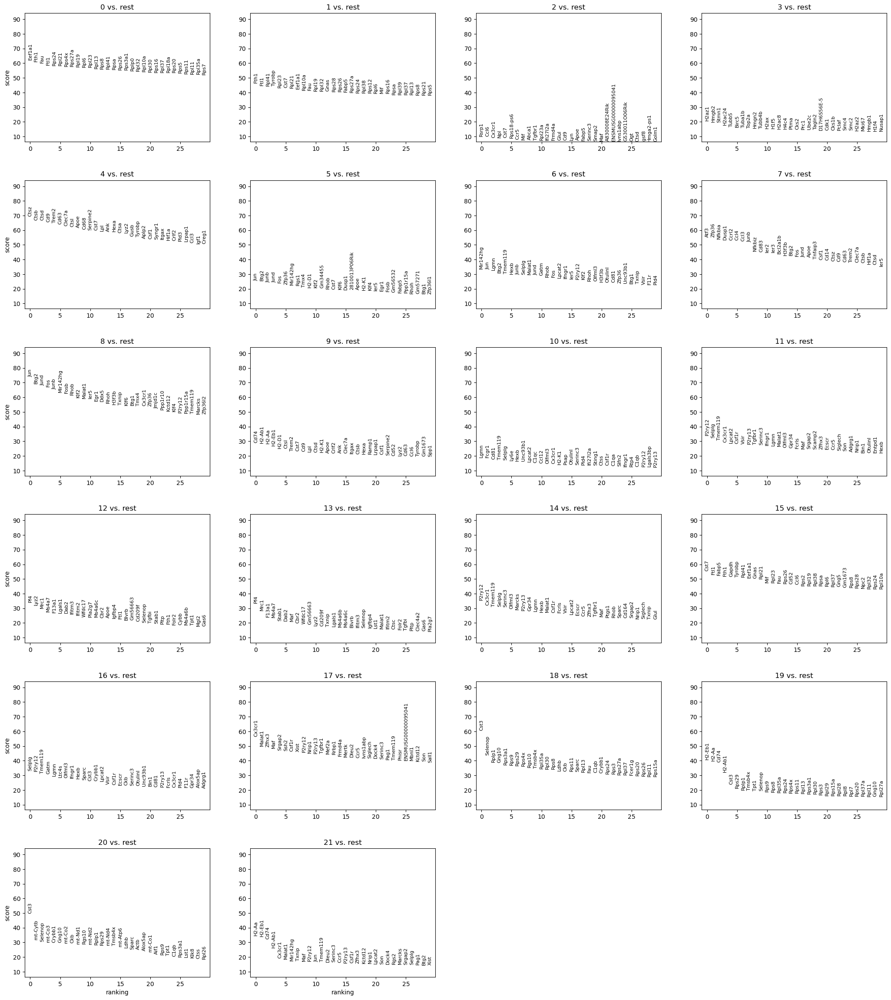

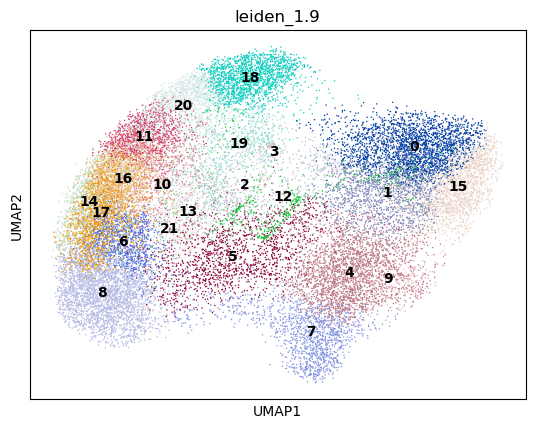

In [38]:
sc.tl.rank_genes_groups(adata, groupby='leiden_1.9', method='wilcoxon', use_raw=False)
sc.pl.rank_genes_groups(adata, groupby='leiden_1.9', key='rank_genes_groups', n_genes=30)
sc.pl.umap(adata, color='leiden_1.9', legend_loc='on data')

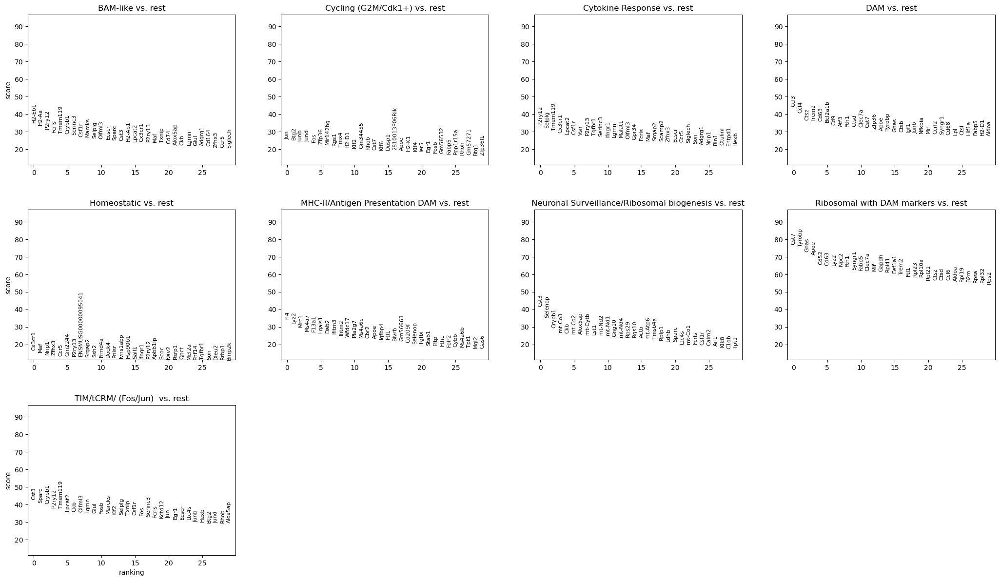

In [39]:
sc.tl.rank_genes_groups(adata, groupby='anno2', method='wilcoxon', use_raw=False)
sc.pl.rank_genes_groups(adata, groupby='anno2', key='rank_genes_groups', n_genes=30)

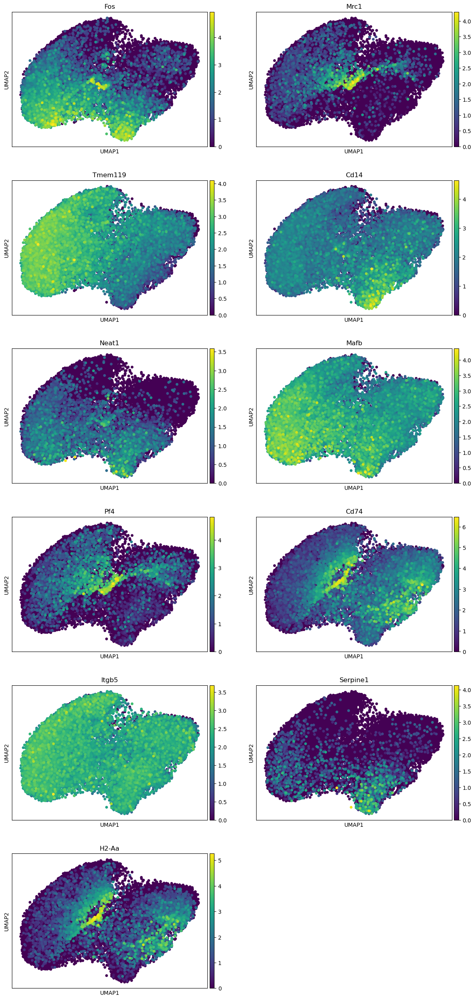

In [40]:
sc.pl.umap(adata, color=['Fos', 'Mrc1', 'Tmem119', 'Cd14', 'Neat1', 'Mafb', 'Pf4', 'Cd74', 'Itgb5', 'Serpine1', 'H2-Aa'], size=100, ncols=2)

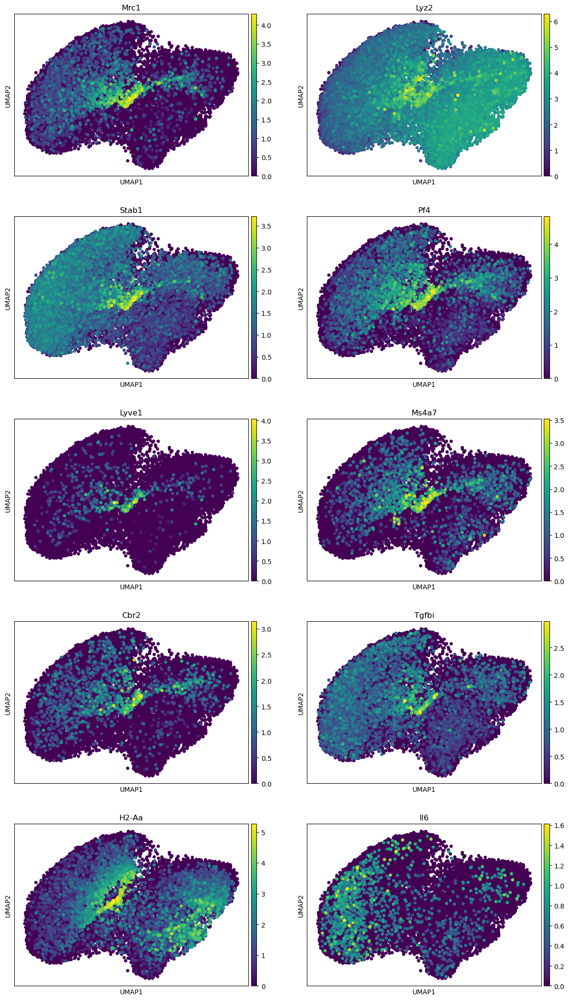

In [41]:
sc.pl.umap(adata, color=['Mrc1', 'Lyz2', 'Stab1', 'Pf4', 'Lyve1', 'Ms4a7', 'Cbr2', 'Tgfbi', 'H2-Aa', 'Il6'], size=100, ncols=2)

In [42]:
adata.obs['anno2'].value_counts()

anno2
Homeostatic                                   6247
TIM/tCRM/ (Fos/Jun)                           5220
Ribosomal with DAM markers                    4733
DAM                                           4137
BAM-like                                      2364
Neuronal Surveillance/Ribosomal biogenesis    2102
Cycling (G2M/Cdk1+)                           1479
Cytokine Response                             1177
MHC-II/Antigen Presentation DAM                482
Name: count, dtype: int64

# Cell Type Visualizations

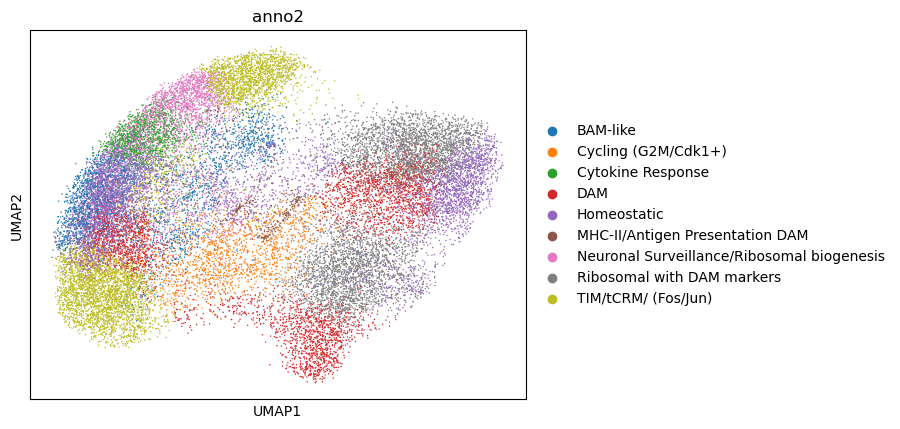

In [43]:
sc.pl.umap(adata, color='anno2')

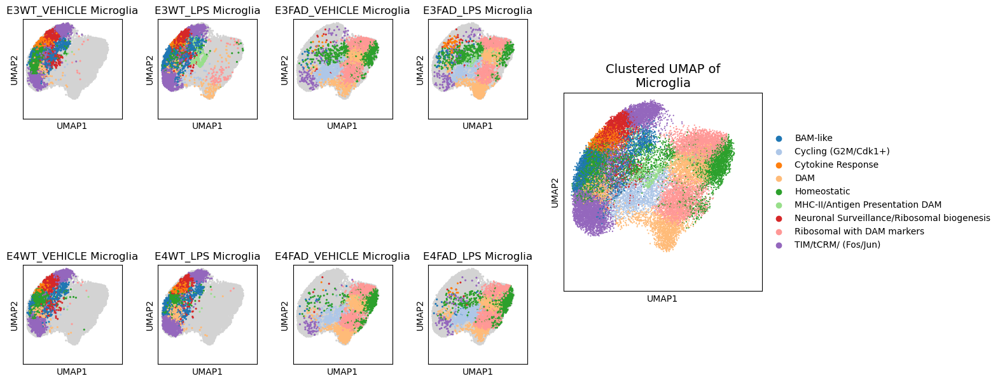

In [44]:
# Define the desired order of categories
desired_order = [
    'E3WT_VEHICLE', 'E4WT_VEHICLE', 'E3WT_LPS', 'E4WT_LPS', 
    'E3FAD_VEHICLE', 'E4FAD_VEHICLE', 'E3FAD_LPS', 'E4FAD_LPS'
]

# Create a contingency table (crosstab) of counts
counts = pd.crosstab(
    adata.obs['genotype_treatment'],
    adata.obs['anno2']
)

# Compute proportions by dividing each count by the row sum
proportions = counts.div(counts.sum(axis=1), axis=0)

# Get the tab20 colormap colors
tab20_colors = plt.get_cmap('tab20').colors
# Ensure you only use as many colors as there are cell types
num_cell_types = proportions.shape[1]
colors = tab20_colors[:num_cell_types]


# Enforce the order on the 'genotype_treatment' column
adata.obs['genotype_treatment'] = pd.Categorical(
    adata.obs['genotype_treatment'],
    categories=desired_order,
    ordered=True
)

# Get the categories directly from the Categorical object
categories = adata.obs['genotype_treatment'].cat.categories.tolist()
n_categories = len(categories)

# Determine the number of columns needed for the category UMAPs
n_category_cols = ceil(n_categories / 2)

# Set up the figure and gridspec with adjusted spacing
fig = plt.figure(figsize=(15, 10), constrained_layout=False)
width_ratios = [1]*n_category_cols + [2]  # General UMAP is wider and on the right
gs = fig.add_gridspec(nrows=2, ncols=n_category_cols + 1, width_ratios=width_ratios)

# Adjust the spacing between subplots
fig.subplots_adjust(hspace=0.01, wspace=0.3)  # Reduce hspace and wspace for better layout

# Create the general UMAP axes on the right
ax_general = fig.add_subplot(gs[:, -1])  # Spans both rows, last column

# Plot the general UMAP
assign_cell_types2(adata)
sc.pl.umap(
    adata,
    color='anno2',
    size=10,
    palette=colors,
    title='Clustered UMAP of\nMicroglia',  # Added newline
    ax=ax_general,
    show=False,  # Prevents the plot from displaying immediately
)
# Set aspect ratio to 'equal' to make the plot square
ax_general.set_aspect('equal')

# Optionally, set x and y limits to be the same for the general UMAP
xlim = ax_general.get_xlim()
ylim = ax_general.get_ylim()
min_limit = min(xlim[0], ylim[0])
max_limit = max(xlim[1], ylim[1])
ax_general.set_xlim(min_limit, max_limit)
ax_general.set_ylim(min_limit, max_limit)

# Adjust the title font size for the general UMAP
ax_general.set_title(ax_general.get_title(), fontsize=14)

# Now plot the category UMAPs without legends
for idx, cat in enumerate(categories):
    # Compute row and column positions
    row = idx % 2
    col = idx // 2  # Category plots occupy the first n_category_cols columns
    ax = fig.add_subplot(gs[row, col])

    # Plot UMAP for the current category
    assign_cell_types2(adata)
    sc.pl.umap(
        adata,
        color='anno2',
        palette=colors,
        groups=None,
        mask_obs=(adata.obs['genotype_treatment'] == cat),
        size=20,
        title=f'{cat} Microglia',  # Added newline
        ax=ax,
        show=False,   # Prevents individual plots from showing
        legend_loc='none'  # Removes the legend
    )
    # Set aspect ratio to 'equal' to make the plot square
    ax.set_aspect('equal')

    # Optionally, set x and y limits to be the same
    xlim = ax.get_xlim()
    ylim = ax.get_ylim()
    min_limit = min(xlim[0], ylim[0])
    max_limit = max(xlim[1], ylim[1])
    ax.set_xlim(min_limit, max_limit)
    ax.set_ylim(min_limit, max_limit)

    # Adjust the title font size to prevent overlap
    ax.set_title(ax.get_title(), fontsize=12)

# # Save and show the figure
plt.savefig("figures/clustered_umap_all.pdf")
plt.show()
# plt.close()

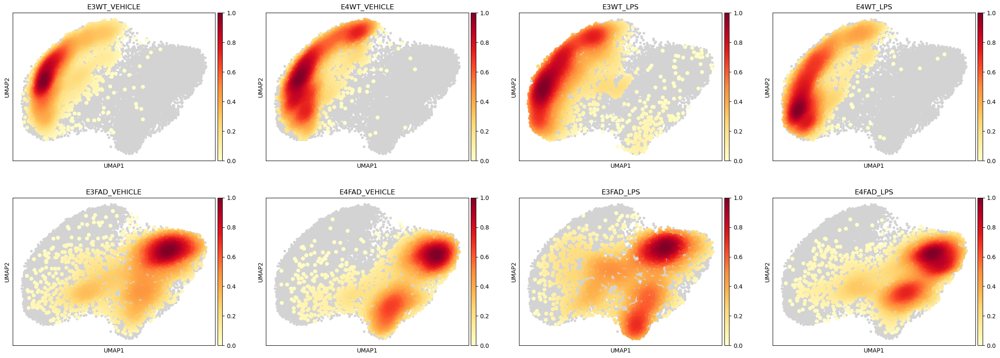

In [45]:
# Density plots for each genotype_treatment group
sc.tl.embedding_density(adata, basis='umap', groupby='genotype_treatment', key_added='umap_density_genotype_treatment')
sc.pl.embedding_density(adata, basis='umap', key='umap_density_genotype_treatment', ncols=4, show=True)
# plt.savefig("figures/umap_density_genotype_treatment.png")

In [46]:
print(adata.obs)

                    K231  K233   K234   K219 Classification  \
AAACCCACACACCTAA-1   5.0   6.0    1.0  339.0           K219   
AAACCCACACTGTGTA-1   5.0   4.0    5.0  313.0           K219   
AAACGAATCATTCCTA-1   3.0   6.0  283.0    7.0           K234   
AAACGCTAGACGCCAA-1  97.0   3.0    7.0    1.0           K231   
AAACGCTAGCCAAGGT-1   2.0   4.0  162.0    3.0           K234   
...                  ...   ...    ...    ...            ...   
TTTGTTGAGGGTTAAT-1   NaN   NaN    NaN    NaN           K283   
TTTGTTGCATTGGATC-1   NaN   NaN    NaN    NaN           K283   
TTTGTTGGTACGGATG-1   NaN   NaN    NaN    NaN           K283   
TTTGTTGGTTCGTAAC-1   NaN   NaN    NaN    NaN           K283   
TTTGTTGTCTGAGTCA-1   NaN   NaN    NaN    NaN           K283   

                    most_likely_hypothesis genotype apoe disease treatment  \
AAACCCACACACCTAA-1                     1.0    E4FAD   E4     FAD       LPS   
AAACCCACACTGTGTA-1                     1.0    E4FAD   E4     FAD       LPS   
AAACGAATC

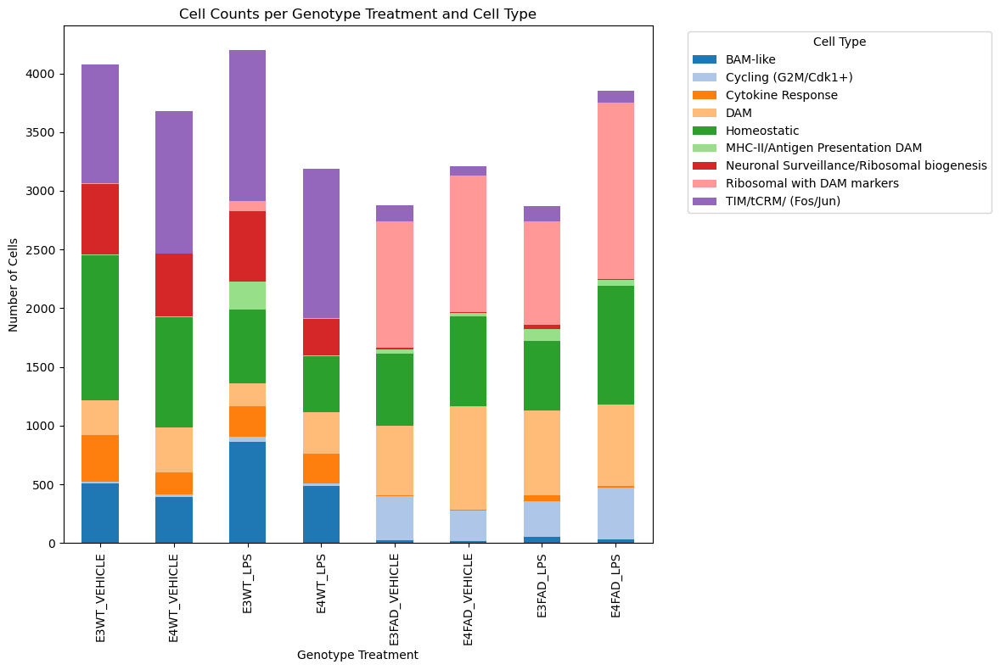

In [47]:
assign_cell_types2(adata)



# Create a contingency table (crosstab) of counts
counts = pd.crosstab(adata.obs['genotype_treatment'], adata.obs['anno2'])

# Get the tab20 colormap colors
tab20_colors = plt.get_cmap('tab20').colors
# Ensure you only use as many colors as there are cell types
num_cell_types = proportions.shape[1]
colors = tab20_colors[:num_cell_types]


# Plot the stacked bar chart
ax = counts.plot(
    kind='bar',
    stacked=True,
    color=colors,
    figsize=(12, 8)
)

# Customize the plot
plt.xlabel('Genotype Treatment')
plt.ylabel('Number of Cells')
plt.title('Cell Counts per Genotype Treatment and Cell Type')
plt.legend(title='Cell Type', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
# plt.savefig("figures/stacked_bar_chart.png")
plt.show()
plt.close()

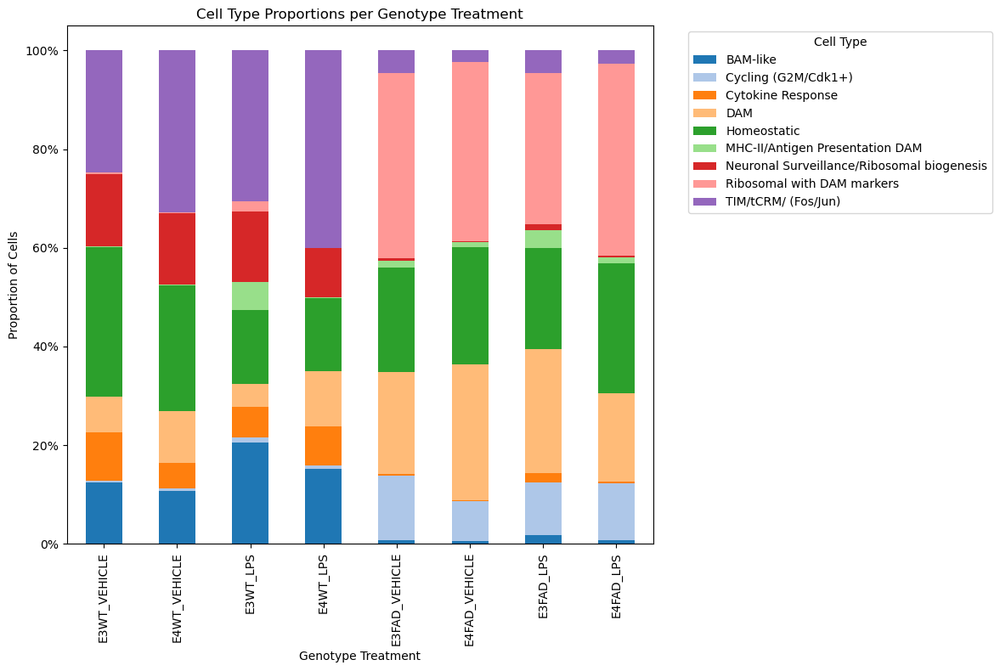

In [48]:
assign_cell_types2(adata)


# Create a contingency table (crosstab) of counts
counts = pd.crosstab(
    adata.obs['genotype_treatment'],
    adata.obs['anno2']
)

# Compute proportions by dividing each count by the row sum
proportions = counts.div(counts.sum(axis=1), axis=0)

# Get the tab20 colormap colors
tab20_colors = plt.get_cmap('tab20').colors
# Ensure you only use as many colors as there are cell types
num_cell_types = proportions.shape[1]
colors = tab20_colors[:num_cell_types]

# Plot the stacked bar chart with the tab20 color palette
ax = proportions.plot(
    kind='bar',
    stacked=True,
    color=colors,
    figsize=(12, 8)
)

# Customize the plot
plt.xlabel('Genotype Treatment')
plt.ylabel('Proportion of Cells')
plt.title('Cell Type Proportions per Genotype Treatment')
ax.yaxis.set_major_formatter(mtick.PercentFormatter(1.0))
plt.legend(
    title='Cell Type',
    bbox_to_anchor=(1.05, 1),
    loc='upper left'
)
plt.tight_layout()
plt.savefig("figures/stacked_bar_chart_proportions.pdf")
plt.show()

In [49]:
# ADD combined categories here

# Compre Annotations to published gene modules (Need to change mouse genes to human genes) 

{'Antigen-presenting response (HLA)': ['H2-ea', 'H2-eb2', 'H2-eb2', 'Cd74', 'H2-dma', 'Apoc1', 'Ms4a6b', 'Ms4a6d', 'Ms4a6c', 'H2-dmb2', 'H2-dmb1', 'H2-ab1', '2410137m14rik', '2410137m14rik', 'Nap1l1', 'Cd37', 'Tmsb10b', 'Apoe', 'Scin', 'Cd9', 'S100a4', '2410137m14rik', 'Apoc2', 'Capg', 'Ms4a7', 'B2m', 'Rpl14', 'Lgals1', 'Rpl26', 'Dhrs7', 'Dhrs7l', 'Rpl34', 'S100a11', 'S100a13', 'Rps8', 'Rps28', 'Rps2', 'Rpl10', 'Rpl10-ps3', 'Rpl12', 'Rpl7a', 'Rps19', 'Rpl11', 'Rps14', 'Rps13', 'Rps23', 'Cfd', 'Rpl28', 'Commd6', 'Rps15a', 'Cytl1', 'Rpl18', 'Arhgap24', 'Epb41l2', 'Rps3a1', 'Naca', 'Rps4x', 'Rps18', 'Rpl30', 'Rps3', 'Clec7a', 'Rpl29', 'Rpl27rt', 'Rpl13', 'Rps27a', 'Rps16', 'Rps21', 'Rpl19', 'Actg1', 'Dbi', 'Rps9', 'Rpl18a', 'Rpl36', 'Rpl8', 'C3ar1', 'Rps6', 'Eef1b2', 'Rps5', 'Khdrbs3', 'Rps15', 'Rpl3', 'Rpl38', 'Fau', 'Rpl24', 'Tmem176b', 'Cd69', 'Rplp1', 'Rplp1rt', 'Cxcr4', 'Rpsa', '2410137m14rik', 'Rps7', 'Rpl22', 'Chchd10', 'Olr1', 'Tspo', 'Ctsh', 'Pfdn5', 'Fabp5', 'Uqcrb', 'Il18', 'Tn

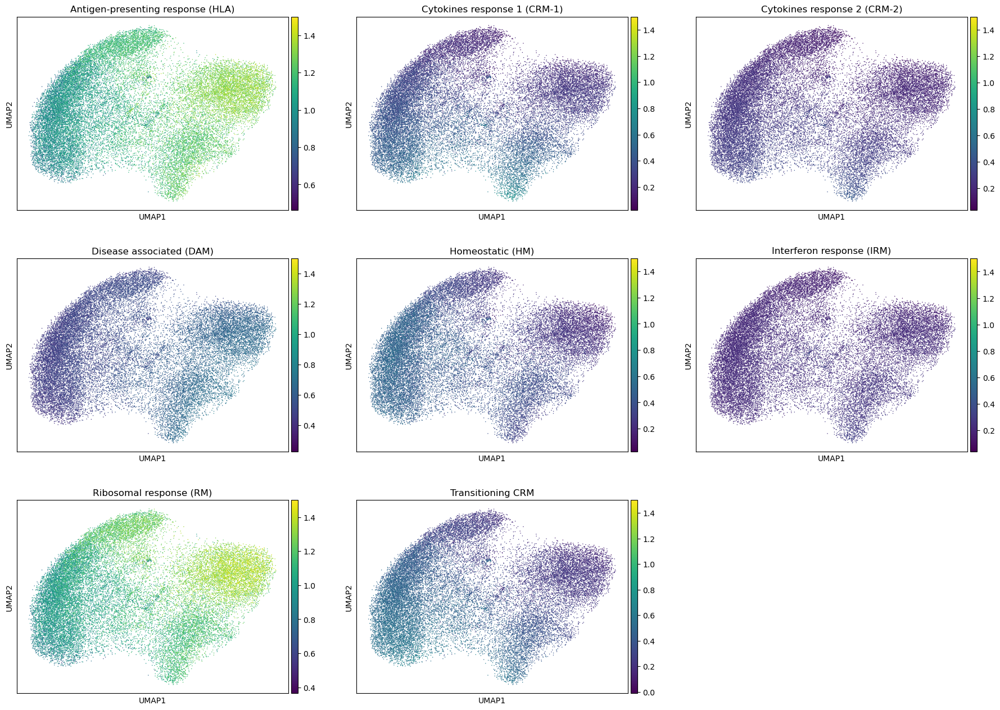

In [50]:
# Read in Mancuso et al. DEG .csv file
mancuso_deg = pd.read_csv('/Users/loganlarlham/Documents/Summer_proj_2024/Notebooks/Analysis/Mancuso_DEG_list/all-Table 1.csv', index_col=0)

# make mancuso_deg geme names from human to mouse


# Make genelists from the Mancuso DEG list, with the name taken from the first column named 'cluster' and each unique element in the second column called 'gene', and a positive value in the third column called 'avg_log2FC'
# Create gene lists from Mancuso DEG dataframe
genelists = {
    cluster: group.loc[group['avg_log2FC'] > 0, 'gene'].tolist()
    for cluster, group in mancuso_deg.groupby('cluster')
}

gp = GProfiler(return_dataframe=True)

# Convert gene lists from human (hsapiens) to mouse (mmusculus)
converted_genelists = {
    cluster: gp.orth(
        organism='hsapiens',
        query=genes,
        target='mmusculus'
    )['name'].tolist()
    for cluster, genes in genelists.items()
}


# More robust camel-case formatting:
for key, value in converted_genelists.items():
    converted_genelists[key] = [gene.capitalize() for gene in value]

# Drop 'N/a' values 
for key, value in converted_genelists.items():
    converted_genelists[key] = [gene for gene in value if gene != 'N/a']
    

print(converted_genelists)

for key, value in converted_genelists.items():
    print(f"Length of {key} genelist before: {len(value)}")

    # Identify dropped genes before filtering
    dropped_genes = [x for x in value if x not in adata.var_names]

    # Filter out genes not in adata.var_names
    filtered_value = [x for x in value if x in adata.var_names]

    # Update the dictionary
    converted_genelists[key] = filtered_value

    print(f"Length of {key} genelist after: {len(filtered_value)}")
    print(f"Dropped genes: {dropped_genes}")

# Use scanpy score_genes function to score the genes in the converted_genelists, loop through each genelist and add the scores to adata.obs with score_name as the key
for key, value in converted_genelists.items():
    print(f"Scoring genes in {key} genelist")
    sc.tl.score_genes(adata, value, score_name=key, ctrl_as_ref=False, ctrl_size=len(converted_genelists[key]), use_raw=False)

# plot umap with the scores colored by the converted_genelists keys
sc.pl.umap(adata, color=list(converted_genelists.keys()), ncols=3, vmax=1.5)


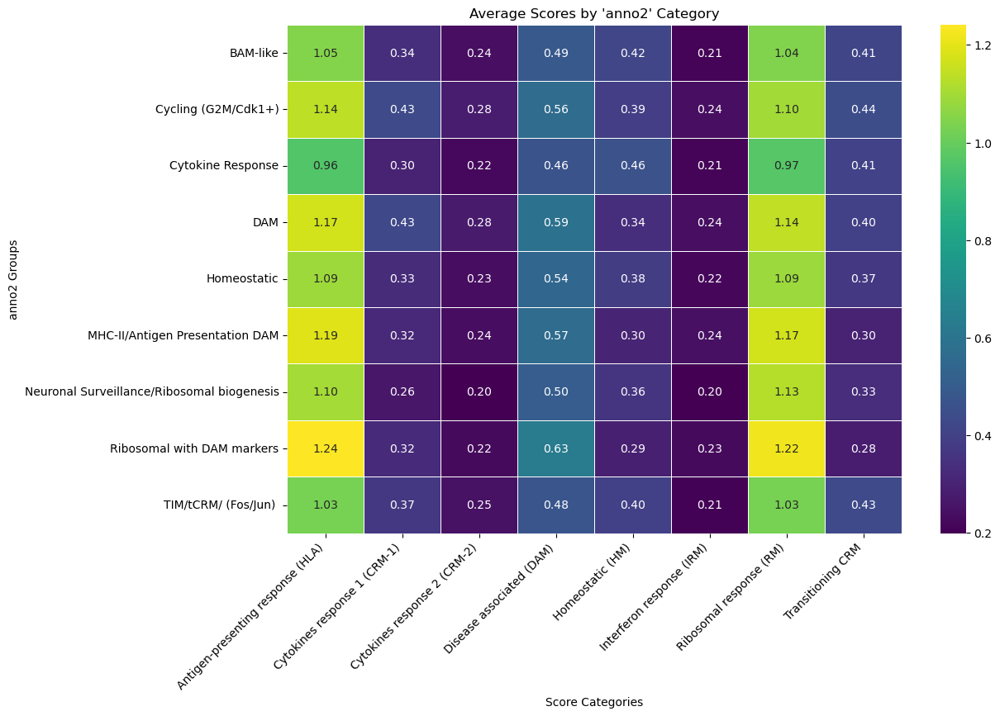

In [51]:
# Define the columns to be averaged
score_columns = [
    'Antigen-presenting response (HLA)', 'Cytokines response 1 (CRM-1)', 'Cytokines response 2 (CRM-2)',
    'Disease associated (DAM)', 'Homeostatic (HM)', 'Interferon response (IRM)', 'Ribosomal response (RM)',
    'Transitioning CRM']

# Group by 'anno2' and compute mean
avg_scores = adata.obs.groupby('anno2')[score_columns].mean()

# Create heatmap
plt.figure(figsize=(12, 8))
sns.heatmap(avg_scores, cmap="viridis", annot=True, fmt=".2f", linewidths=0.5)

# Customize plot
plt.title("Average Scores by 'anno2' Category")
plt.xlabel("Score Categories")
plt.ylabel("anno2 Groups")
plt.xticks(rotation=45, ha='right')

# Show plot
plt.show()

# Cell Type Two-way Anovas with Tukey

Comparison with only FAD groups

In [52]:
# # Because I have individual sample labels in the 'classification' column, I want to use this to calculate the porportion of each cell type "anno2" in each sample and then plot the % of high ribosomal DAM
# #  cells in each sample as a bar graph, grouped by genotype and treatment and then a 2 way anova to see if there is a significant difference between the groups

# # Create a mapping from cell types to safe column names
# cell_types = adata.obs['anno2'].unique()

# # Set Order of 'treatment' so that it appears in the correct order in the plot. 1st is VEHICLE, 2nd is LPS
# adata.obs['treatment'] = adata.obs['treatment'].cat.reorder_categories(['VEHICLE', 'LPS'])

# # Set Order of 'apoe' so that it appears in the correct order in the plot. 1st is E3, 2nd is E4
# adata.obs['apoe'] = adata.obs['apoe'].cat.reorder_categories(['E3', 'E4'])



# # Function to create safe column names
# def make_safe_column_name(name):
#     return re.sub(r'\W+', '_', name)

# # Create a mapping from original cell type names to safe column names
# cell_type_map = {ct: make_safe_column_name(ct) for ct in cell_types}

# # First make a dataframe with each sample as a row
# anv_df = pd.DataFrame(index=adata.obs['Classification'].unique())

# # Add the 'apoe', 'treatment', and 'disease' columns
# anv_df['apoe'] = adata.obs.groupby('Classification')['apoe'].first().values
# anv_df['treatment'] = adata.obs.groupby('Classification')['treatment'].first().values
# anv_df['disease'] = adata.obs.groupby('Classification')['disease'].first().values

# # Convert columns to category type
# anv_df['apoe'] = anv_df['apoe'].astype('category')
# anv_df['treatment'] = anv_df['treatment'].astype('category')
# anv_df['disease'] = anv_df['disease'].astype('category')

# # Add the percentage of each cell type in each sample
# for ct in cell_types:
#     ct_safe = cell_type_map[ct]
#     # Calculate the percentage of each cell type in each sample
#     anv_df[ct_safe] = adata.obs.groupby('Classification')['anno2'].apply(
#         lambda x: (x == ct).sum() / len(x) * 100
#     ).values

# # Loop through each cell type to perform analysis and plotting
# for ct in cell_types:
#     ct_safe = cell_type_map[ct]
#     print(f"Processing cell type: {ct}")

#     # Select data for disease = 'FAD'
#     # fad_df = anv_df[anv_df['disease'] == 'FAD'].copy()

#     # Prepare data for plotting and analysis
#     # Melt the dataframe to long form
#     fad_df_long = anv_df.melt(
#         id_vars=['apoe', 'treatment', 'disease'],
#         var_name='cell_type',
#         value_name='percent'
#     )

#     # Filter for the current cell type
#     fad_df_long = fad_df_long[fad_df_long['cell_type'] == ct_safe]

#     # Check if there is data for this cell type
#     if fad_df_long.empty:
#         print(f"No data for cell type {ct} in disease FAD.")
#         continue  # Skip to the next cell type

#     # Perform Two-Way ANOVA
#     formula = 'percent ~ C(apoe) + C(treatment) + C(apoe):C(treatment)'
#     model = ols(formula, data=fad_df_long).fit()
#     anova_table = sm.stats.anova_lm(model, typ=2)
#     print(f"Two-Way ANOVA Results for cell type {ct}:")
#     print(anova_table)

#     # Perform Tukey's HSD test
#     fad_df_long['group'] = fad_df_long['apoe'].astype(str) + "_" + fad_df_long['treatment'].astype(str)
#     tukey = pairwise_tukeyhsd(
#         endog=fad_df_long['percent'],
#         groups=fad_df_long['group'],
#         alpha=0.05
#     )
#     print(f"\nTukey HSD Post-Hoc Test Results for cell type {ct}:")
#     print(tukey.summary())

#     # Optional: Visualize the Tukey HSD test results
#     tukey.plot_simultaneous(comparison_name=fad_df_long['group'].unique()[0])
#     plt.title(f'Tukey HSD Post-Hoc Test for {ct}')
#     plt.xlabel('Mean Difference')
#     plt.show()

#     # Plotting
#     plt.figure(figsize=(12, 8))
#     ax = sns.barplot(
#         data=fad_df_long,
#         x='apoe',
#         y='percent',
#         hue='treatment',
#         ci='sd',
#         errwidth=1,
#         capsize=0.1
#     )

#     # Overlay individual sample points as diamond shapes
#     sns.stripplot(
#         data=fad_df_long,
#         x='apoe',
#         y='percent',
#         hue='treatment',
#         dodge=True,
#         jitter=False,
#         marker='D',
#         size=7,
#         edgecolor='black',
#         linewidth=1,
#         ax=ax,
#         palette='dark',
#         legend=False  # Prevent duplicate legends
#     )

#     # Adjust the legend to avoid duplicates
#     handles, labels = ax.get_legend_handles_labels()
#     n_apoe = fad_df_long['apoe'].nunique()
#     ax.legend(handles[:n_apoe], labels[:n_apoe], title='apoe')

#     # Set plot labels and title
#     plt.title(f'Percentage of {ct} Cells in FAD Samples')
#     plt.ylabel(f'Percentage of {ct} Cells')
#     plt.xlabel('Treatment')
#     # Show the plot
#     plt.show()

Cpomparison with all groups. 

Processing cell type: Ribosomal with DAM markers
Three-Way ANOVA Results for cell type Ribosomal with DAM markers:
                                      sum_sq    df            F        PR(>F)
C(apoe)                            15.605348   1.0     2.521103  1.266014e-01
C(disease)                       9544.954612   1.0  1542.023550  7.220826e-22
C(treatment)                        0.604564   1.0     0.097670  7.575875e-01
C(apoe):C(disease)                 24.812191   1.0     4.008503  5.775071e-02
C(apoe):C(treatment)               28.497767   1.0     4.603922  4.318991e-02
C(disease):C(treatment)             5.727759   1.0     0.925341  3.465311e-01
C(apoe):C(disease):C(treatment)    42.573315   1.0     6.877880  1.554720e-02
Residual                          136.177558  22.0          NaN           NaN

Tukey HSD Post-Hoc Test Results for cell type Ribosomal with DAM markers:
         Multiple Comparison of Means - Tukey HSD, FWER=0.05          
    group1         group2     meandif

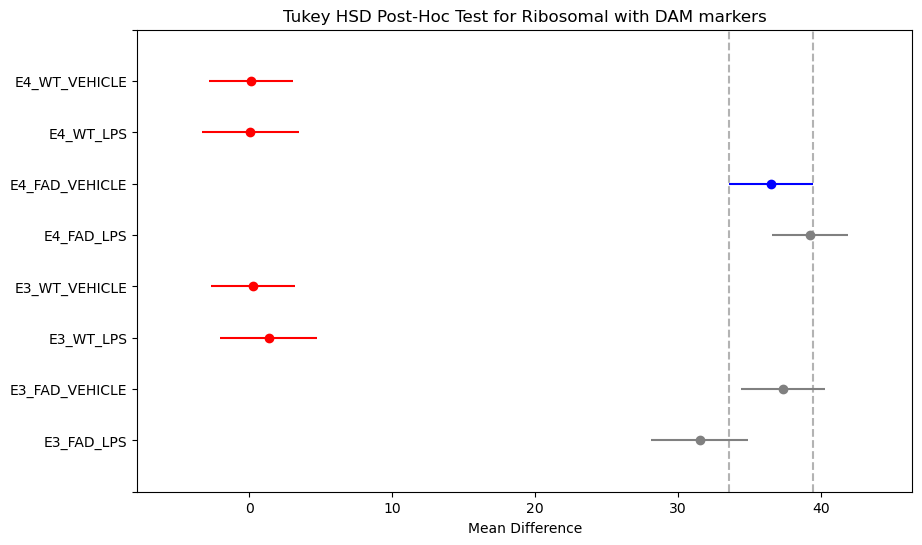

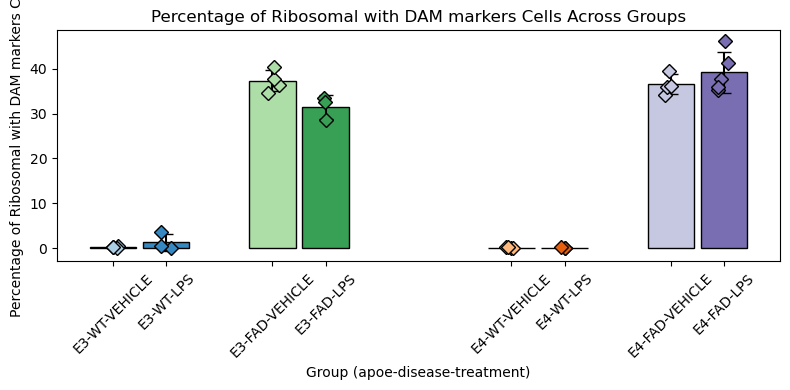

Processing cell type: Homeostatic
Three-Way ANOVA Results for cell type Homeostatic:
                                      sum_sq    df         F    PR(>F)
C(apoe)                             1.650334   1.0  0.025428  0.874759
C(disease)                          4.028126   1.0  0.062065  0.805572
C(treatment)                      128.443347   1.0  1.979051  0.173461
C(apoe):C(disease)                100.086121   1.0  1.542124  0.227379
C(apoe):C(treatment)                0.399645   1.0  0.006158  0.938163
C(disease):C(treatment)           328.245247   1.0  5.057593  0.034863
C(apoe):C(disease):C(treatment)     0.063492   1.0  0.000978  0.975330
Residual                         1427.832476  22.0       NaN       NaN

Tukey HSD Post-Hoc Test Results for cell type Homeostatic:
         Multiple Comparison of Means - Tukey HSD, FWER=0.05         
    group1         group2     meandiff p-adj   lower    upper  reject
---------------------------------------------------------------------
    E3

<Figure size 640x480 with 0 Axes>

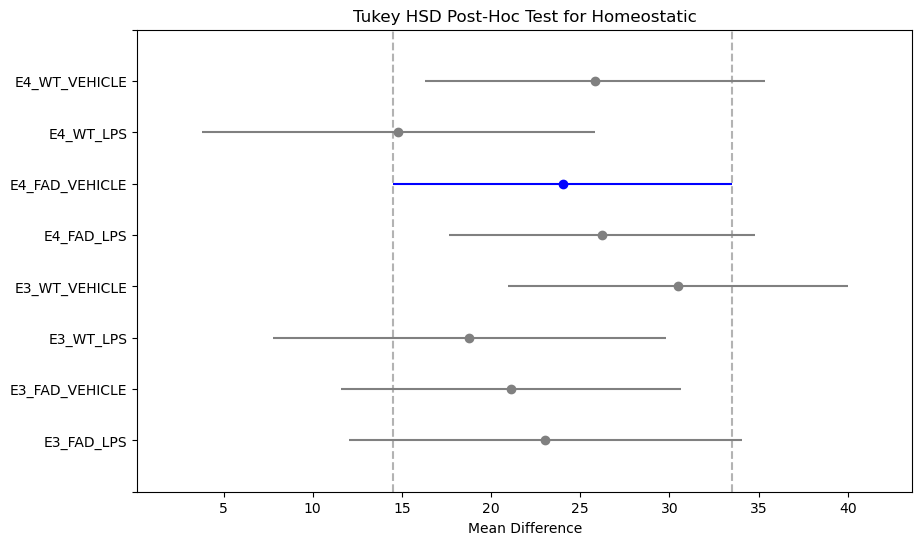

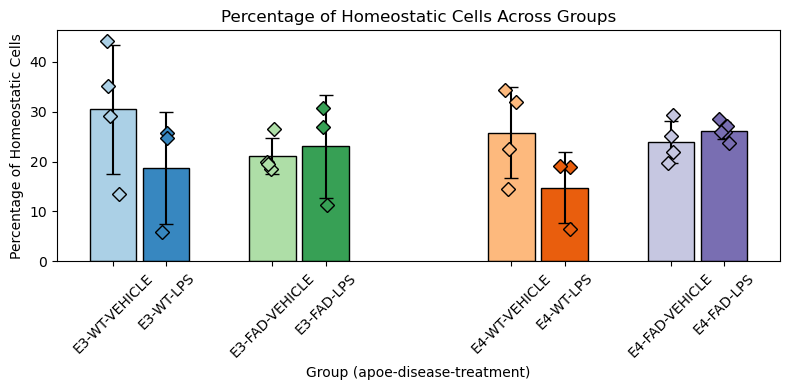

Processing cell type: DAM
Three-Way ANOVA Results for cell type DAM:
                                      sum_sq    df          F    PR(>F)
C(apoe)                            77.210244   1.0   1.953647  0.176130
C(disease)                       1366.910030   1.0  34.586857  0.000006
C(treatment)                       62.742033   1.0   1.587559  0.220878
C(apoe):C(disease)                 20.484951   1.0   0.518330  0.479135
C(apoe):C(treatment)               27.675566   1.0   0.700273  0.411690
C(disease):C(treatment)            15.484460   1.0   0.391803  0.537794
C(apoe):C(disease):C(treatment)   103.022511   1.0   2.606774  0.120660
Residual                          869.463817  22.0        NaN       NaN

Tukey HSD Post-Hoc Test Results for cell type DAM:
         Multiple Comparison of Means - Tukey HSD, FWER=0.05         
    group1         group2     meandiff p-adj   lower    upper  reject
---------------------------------------------------------------------
    E3_FAD_LPS E3_FAD

<Figure size 640x480 with 0 Axes>

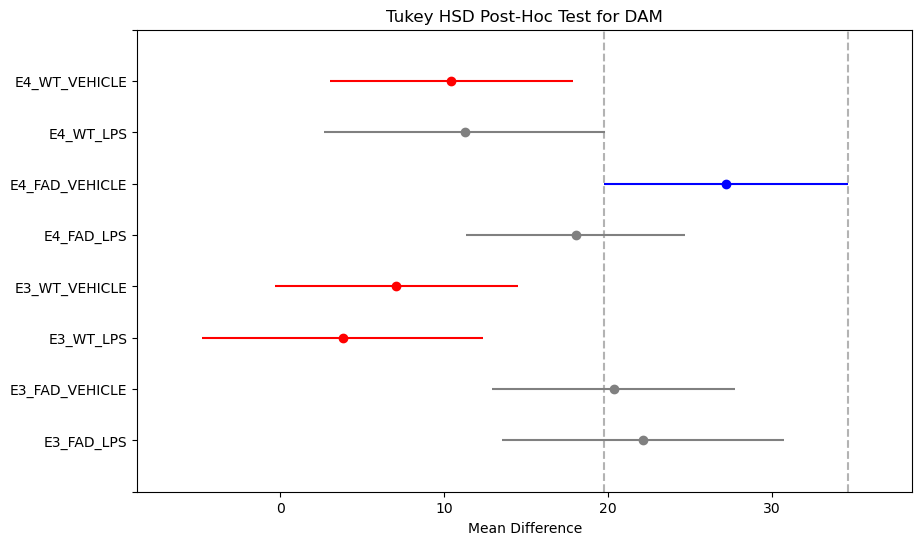

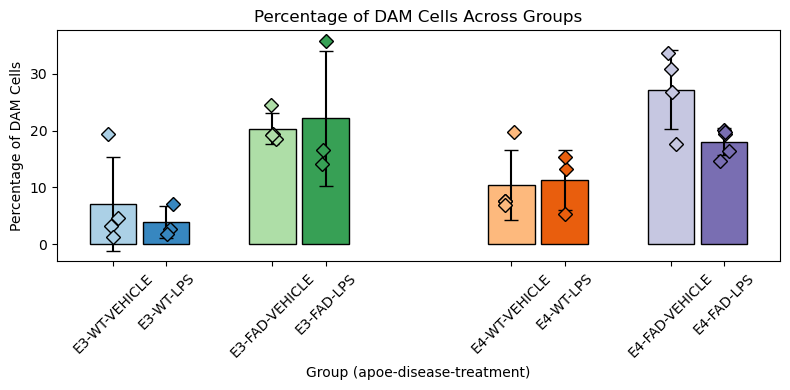

Processing cell type: Cycling (G2M/Cdk1+)
Three-Way ANOVA Results for cell type Cycling (G2M/Cdk1+):
                                     sum_sq    df           F        PR(>F)
C(apoe)                            9.152317   1.0    2.789113  1.090751e-01
C(disease)                       778.719342   1.0  237.309994  2.870922e-13
C(treatment)                       1.868143   1.0    0.569305  4.585363e-01
C(apoe):C(disease)                 8.953615   1.0    2.728560  1.127712e-01
C(apoe):C(treatment)              15.241922   1.0    4.644883  4.235243e-02
C(disease):C(treatment)            0.046067   1.0    0.014039  9.067583e-01
C(apoe):C(disease):C(treatment)   18.962883   1.0    5.778824  2.508376e-02
Residual                          72.191758  22.0         NaN           NaN

Tukey HSD Post-Hoc Test Results for cell type Cycling (G2M/Cdk1+):
         Multiple Comparison of Means - Tukey HSD, FWER=0.05         
    group1         group2     meandiff p-adj   lower    upper  reject
-------

<Figure size 640x480 with 0 Axes>

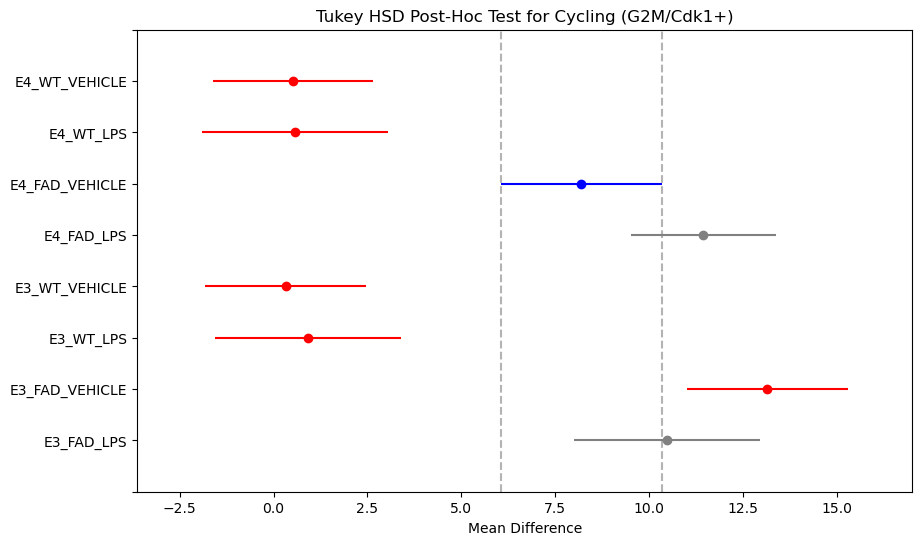

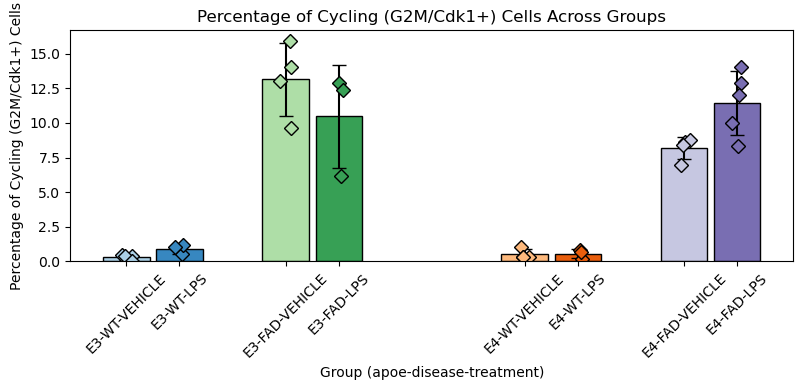

FileNotFoundError: [Errno 2] No such file or directory: 'figures/Cycling (G2M/Cdk1+)_cells_across_groups.pdf'

<Figure size 640x480 with 0 Axes>

In [53]:
# Create a mapping from cell types to safe column names
cell_types = adata.obs['anno2'].unique()

# Set Order of 'treatment' so that it appears in the correct order in the plot.
adata.obs['treatment'] = adata.obs['treatment'].cat.reorder_categories(['VEHICLE', 'LPS'])

# Set Order of 'apoe' so that it appears in the correct order in the plot.
adata.obs['apoe'] = adata.obs['apoe'].cat.reorder_categories(['E3', 'E4'])

# Function to create safe column names
def make_safe_column_name(name):
    return re.sub(r'\W+', '_', name)

# Create a mapping from original cell type names to safe column names
cell_type_map = {ct: make_safe_column_name(ct) for ct in cell_types}

# Make a dataframe with each sample as a row
anv_df = pd.DataFrame(index=adata.obs['Classification'].unique())

# Add the 'apoe', 'treatment', and 'disease' columns
anv_df['apoe'] = adata.obs.groupby('Classification')['apoe'].first().values
anv_df['treatment'] = adata.obs.groupby('Classification')['treatment'].first().values
anv_df['disease'] = adata.obs.groupby('Classification')['disease'].first().values

# Convert columns to category type
anv_df['apoe'] = anv_df['apoe'].astype('category')
anv_df['treatment'] = anv_df['treatment'].astype('category')
anv_df['disease'] = anv_df['disease'].astype('category')

# Add the percentage of each cell type in each sample
for ct in cell_types:
    ct_safe = cell_type_map[ct]
    anv_df[ct_safe] = adata.obs.groupby('Classification')['anno2'].apply(
        lambda x: (x == ct).sum() / len(x) * 100
    ).values

# Loop through each cell type to perform analysis and plotting
for ct in cell_types:
    ct_safe = cell_type_map[ct]
    print(f"Processing cell type: {ct}")

    # Prepare data for plotting and analysis by melting the dataframe
    df_long = anv_df.melt(
        id_vars=['apoe', 'treatment', 'disease'],
        var_name='cell_type',
        value_name='percent'
    )
    
    # Filter for the current cell type
    df_long = df_long[df_long['cell_type'] == ct_safe]
    
    # Check if there is data for this cell type
    if df_long.empty:
        print(f"No data for cell type {ct}.")
        continue  # Skip to the next cell type

    # Create a combined group that includes apoe, disease, and treatment.
    df_long['group'] = (df_long['apoe'].astype(str) + "_" +
                        df_long['disease'].astype(str) + "_" +
                        df_long['treatment'].astype(str))
        # Define the desired order for groups.
    # (Adjust these names to match your actual category names if needed)
    desired_order = [
        "E3_WT_VEHICLE", "E3_WT_LPS",
        "E3_FAD_VEHICLE", "E3_FAD_LPS",
        "E4_WT_VEHICLE", "E4_WT_LPS",
        "E4_FAD_VEHICLE", "E4_FAD_LPS"
    ]

    # Convert 'group' to a categorical variable with this order
    df_long['group'] = pd.Categorical(df_long['group'], categories=desired_order, ordered=True)

    # Define custom x positions for each group.
    # Here, the first two (E3 WT) are placed close together, then a gap before E3 FAD, then a larger gap between E3 and E4.
    positions = {
        "E3_WT_VEHICLE": 0.0,
        "E3_WT_LPS": 0.4,
        "E3_FAD_VEHICLE": 1.2,
        "E3_FAD_LPS": 1.6,
        "E4_WT_VEHICLE": 3.0,
        "E4_WT_LPS": 3.4,
        "E4_FAD_VEHICLE": 4.2,
        "E4_FAD_LPS": 4.6,
    }
    # Map these positions into a new column
    df_long['x'] = df_long['group'].map(positions)
    # Define color palettes for E3 and E4.
    e3_wt_palette = sns.color_palette("Blues", 2)   # two shades for WT vs FAD in E3
    e3_fad_palette = sns.color_palette("Greens", 2)  # two shades for WT vs FAD in E3
    e4_wt_palette = sns.color_palette("Oranges", 2)  # two shades for WT vs FAD in E4
    e4_fad_palette = sns.color_palette("Purples", 2)    # two shades for WT vs FAD in E4


    # Map groups to colors (using the same color for the two treatments within each disease group)
    color_dict = {
        "E3_WT_VEHICLE": e3_wt_palette[0],
        "E3_WT_LPS": e3_wt_palette[1],
        "E3_FAD_VEHICLE": e3_fad_palette[0],
        "E3_FAD_LPS": e3_fad_palette[1],
        "E4_WT_VEHICLE": e4_wt_palette[0],
        "E4_WT_LPS": e4_wt_palette[1],
        "E4_FAD_VEHICLE": e4_fad_palette[0],
        "E4_FAD_LPS": e4_fad_palette[1],
    }

    # Compute group statistics (mean and standard deviation)
    group_stats = df_long.groupby('group')['percent'].agg(['mean', 'std']).reindex(desired_order)
    # Add x positions from our mapping
    group_stats['x'] = [positions[g] for g in desired_order]
            
    
    # Example: Perform a Three-Way ANOVA (apoe, disease, treatment and interactions)
    formula = ('percent ~ C(apoe) + C(disease) + C(treatment) + '
               'C(apoe):C(disease) + C(apoe):C(treatment) + C(disease):C(treatment) + '
               'C(apoe):C(disease):C(treatment)')
    model = ols(formula, data=df_long).fit()
    anova_table = sm.stats.anova_lm(model, typ=2)
    print(f"Three-Way ANOVA Results for cell type {ct}:")
    print(anova_table)

    # Perform Tukey's HSD test using the new group definitions
    tukey = pairwise_tukeyhsd(
        endog=df_long['percent'],
        groups=df_long['group'],
        alpha=0.05
    )
    print(f"\nTukey HSD Post-Hoc Test Results for cell type {ct}:")
    print(tukey.summary())

    # Optional: Visualize the Tukey HSD test results
    tukey.plot_simultaneous(comparison_name=df_long['group'].unique()[0])
    plt.title(f'Tukey HSD Post-Hoc Test for {ct}')
    plt.xlabel('Mean Difference')
    plt.show()


    # Plot using matplotlib's bar
    plt.figure(figsize=(8, 4))
    ax = plt.gca()

    # Set a smaller bar width for “skinnier” bars
    bar_width = 0.35

    # Plot the bars with error bars
    ax.bar(
        group_stats['x'],
        group_stats['mean'],
        yerr=group_stats['std'],
        width=bar_width,
        color=[color_dict[g] for g in desired_order],
        capsize=5,
        edgecolor='black'
    )

    # Overlay individual sample points (as diamonds) with slight x jitter
    for g in desired_order:
        subset = df_long[df_long['group'] == g]
        x_pos = positions[g]
        # Create a small random jitter around the x position
        jitter = np.random.uniform(-0.05, 0.05, size=len(subset))
        ax.plot(
            x_pos + jitter,
            subset['percent'],
            'D',
            markersize=7,
            markeredgecolor='black',
            markerfacecolor=color_dict[g],  # Use same color as the corresponding bar
            linestyle='none'
        )

    # Set custom x-axis ticks and labels
    ax.set_xticks([positions[g] for g in desired_order])
    # Replace underscores with dashes for prettier labels (e.g. "E3-WT-VEHICLE")
    ax.set_xticklabels([g.replace("_", "-") for g in desired_order], rotation=45)

    plt.title(f'Percentage of {ct} Cells Across Groups')
    plt.ylabel(f'Percentage of {ct} Cells')
    plt.xlabel('Group (apoe-disease-treatment)')
    plt.tight_layout()
    plt.show()
    plt.savefig(f"figures/{ct}_cells_across_groups.pdf")

# Wilcoxon DEG Visualizations

In [ ]:
# Get DEGs for Veh vs LPS in adata subsets (genotype_treatment)

for adata_subset in adata_subs:
    adata_subset.X = adata_subset.layers['log_norm'].copy()
    sc.tl.rank_genes_groups(adata_subset, groupby='treatment', method='wilcoxon')

In [ ]:
e3fad_LPS_sig_genes = f.plot_volcano(adata_e3fad, group='LPS', logfc_threshold=0.25, pval_threshold=0.05, top_n=200 )

print(f"Up-Regulated {len(e3fad_LPS_sig_genes['Up-regulated'])}: {e3fad_LPS_sig_genes['Up-regulated']}")
print(f"Down-Regulated {len(e3fad_LPS_sig_genes['Down-regulated'])} : {e3fad_LPS_sig_genes['Down-regulated']}")




In [ ]:
e4fad_LPS_sig_genes = f.plot_volcano(adata_e4fad, group='LPS', logfc_threshold=0.1, pval_threshold=0.05, top_n=15 )

print(f"Up-Regulated {len(e4fad_LPS_sig_genes['Up-regulated'])} : {e4fad_LPS_sig_genes['Up-regulated']}")
print(f"Down-Regulated {len(e4fad_LPS_sig_genes['Down-regulated'])} : {e4fad_LPS_sig_genes['Down-regulated']}")

### Wilcoxon FAD vs WT in VEH comparison

In [ ]:
adata_e3_lps.obs['disease'].unique()

In [ ]:
for adata_subset in adata_subs:
    adata_subset.X = adata_subset.layers['log_norm'].copy()
    if adata_subset.obs['treatment'][0] and adata_subset.obs['treatment'][-1] == 'VEHICLE':
        if len(adata_subset.obs['disease'].unique()) != 1: 
            print(f"Processing {adata_subset.uns['name']}...")
            sc.tl.rank_genes_groups(adata_subset, groupby='disease', method='wilcoxon')

In [ ]:
E4VEH_sig_genes = f.plot_volcano(adata=adata_e4_vehicle, group='FAD', logfc_threshold=1, pval_threshold=0.05, top_n=200 )
print(E4VEH_sig_genes)

In [ ]:
sc.tl.rank_genes_groups(adata, groupby='anno2', method='wilcoxon', use_raw=False)
sc.tl.dendrogram(adata, groupby='anno2', use_raw=False)

In [ ]:
sc.pl.rank_genes_groups_dotplot(adata, n_genes=10, groupby='anno2', key='rank_genes_groups')

In [ ]:
#heatmap of found marker genes by cluster
sc.pl.rank_genes_groups_matrixplot(adata, n_genes=10, groupby='anno2', key='rank_genes_groups', min_logfoldchange=1.1, vmax=4, cmap='viridis')

In [ ]:
sc.tl.rank_genes_groups(adata, groupby='anno2', method='wilcoxon', rankby_abs=False, pts=True)
adata.X = adata.layers['log_norm'].copy()
adata_scale = sc.pp.scale(adata, copy=True)
sc.pl.rank_genes_groups_matrixplot(adata_scale, n_genes=10, groupby='anno2', key='rank_genes_groups', min_logfoldchange=0.9, vmax=3, vmin=-3,cmap='bwr', save='rank_genes_groups_matrixplot.pdf')

In [ ]:
# sc.pl.heatmap(adata, groupby='anno2', var_names=found_marker_genes, cmap='RdBu_r',  use_raw=False, figsize=(12, 12), show_gene_labels=True, vmax=5)

# Pseudobulk with Decoupler

In [ ]:
for adata_sub in adata_subs:
    print(f"checking {adata_sub.uns['name']}")
    print(adata_sub.layers['counts'][:5, :5])  
    print(adata_sub.layers['log_norm'][:5, :5])
    print(f"Counts - Min: {adata_sub.layers['counts'].min()}, Max: {adata_sub.layers['counts'].max()}")
    print(f"Log Norm - Min: {adata_sub.layers['log_norm'].min()}, Max: {adata_sub.layers['log_norm'].max()}")
    print(f"X - Min: {adata_sub.X.min()}, Max: {adata_sub.X.max()}")
    # print(f"Inf Count: {np.isinf(adata_sub.layers['log_norm']).sum()}")
    # print(f"NaN Count: {np.isnan(adata_sub.layers['log_norm']).sum()}")
    print(f"X data type: {adata_sub.X.dtype}")
    print(f"Log Norm data type: {adata_sub.layers['log_norm'].dtype}")
    print(f"Counts shape: {adata_sub.layers['counts'].shape}")

In [ ]:
subsets = [adata_e3wt, adata_e4wt, adata_e3fad, adata_e4fad]

for sadata in subsets:
    sadata.X = sadata.layers['counts'].toarray() 

In [ ]:

# Create dictionaries to store results
vehlps_stats = {}
dc_vehlps_results = {}
dc_vehlps_results_sig = {}
dc_vehlps_upreg = {}
dc_vehlps_downreg = {}


for sadata in subsets:
    a_name = sadata.uns['name']
    apoe = a_name[:2]
    disease = a_name[2:]

    dc_adata = ''

    sadata.X = sadata.layers['counts'].toarray()
    print(f"Processing {a_name}...")
    print(f"Apoe: {apoe}, Disease: {disease}")

    # Get pseudo-bulk profile
    dc_adata = dc.get_pseudobulk(
        sadata,
        sample_col='Classification',
        groups_col='genotype',
        mode='sum',
        min_cells=0,
        min_counts=0
    )

    dc.plot_psbulk_samples(dc_adata, groupby=['Classification', 'genotype', 'sample'], figsize=(12, 4))

    # Store raw counts in layers
    dc_adata.layers['counts'] = dc_adata.X.copy()

    # Normalize, scale and compute pca
    sc.pp.normalize_total(dc_adata, target_sum=1e4)
    sc.pp.log1p(dc_adata)
    sc.pp.scale(dc_adata, max_value=10)
    sc.tl.pca(dc_adata)

    dc.swap_layer(dc_adata, 'counts', inplace=True)

    sc.pl.pca(dc_adata, color=['disease', 'genotype', 'apoe', 'treatment', 'genotype_treatment', 'sample'], ncols=3, size=300)
    sc.pl.pca(dc_adata, color=['disease', 'genotype', 'apoe', 'treatment'], dimensions=(2,3), annotate_var_explained=True, ncols=2, size=300)
    sc.pl.pca_variance_ratio(dc_adata)

    dc.get_metadata_associations(
        dc_adata,
        obs_keys = [ 'treatment', 'psbulk_n_cells', 'psbulk_counts',],  # Metadata columns to associate to PCs
        obsm_key='X_pca',  # Where the PCs are stored
        uns_key='pca_anova',  # Where the results are stored
        inplace=True,
    )


    pca_scores = dc_adata.obsm['X_pca']
    print("Any NaN in PCA scores:", np.isnan(pca_scores).any())
    print("Any Inf in PCA scores:", np.isinf(pca_scores).any())
    anova_results = dc_adata.uns['pca_anova']
    print("Any NaN in p-values:", anova_results['p_adj'].isna().any())
    print("Any Inf in p-values:", np.isinf(anova_results['p_adj']).any())
    print('pca_anova' in dc_adata.uns)
    print('X_pca' in dc_adata.obsm)
    print(dc_adata.obs.columns)
    n_components = dc_adata.obsm['X_pca'].shape[1]
    print("Number of PCs available:", n_components)
    pca_variance = dc_adata.obsm['X_pca'].var(axis=0)
    print("PCA Component Variances:")
    print(pca_variance)

    # dc.plot_associations(
    #     dc_adata,
    #     uns_key='pca_anova',  # Summary statistics from the anova tests
    #     obsm_key='X_pca',  # where the PCs are stored
    #     stat_col='p_adj',  # Which summary statistic to plot
    #     obs_annotation_cols = ['treatment', 'sample'], # which sample annotations to plot
    #     titles=[(f"{a_name} Principle component scores"), (f"{a_name}Adjusted p-values from ANOVA")],
    #     figsize=(7, 5),
    #     n_factors=n_components,
    # )

    sc.pl.pca(dc_adata, color='treatment', size=300)

    #Build DESeq2 object
    inference = DefaultInference(n_cpus=8)
    dds = DeseqDataSet(
        adata=dc_adata,
        design_factors=['treatment'],
        refit_cooks=True,
        inference=inference,
    )

    dds.deseq2()

    key = f"{apoe}{disease}_vehlps"

    # Perform DESeq2 analysis
    dds = DeseqStats(dds, contrast=['treatment', 'LPS', 'VEHICLE'])
    dds.summary()

    # Store results in dictionaries
    vehlps_stats[key] = dds
    dc_vehlps_results[key] = dds.results_df

    # Filter significant results
    sig_results = dc_vehlps_results[key][dc_vehlps_results[key]['log2FoldChange'].abs() > 0.25]
    sig_results = sig_results[sig_results['padj'] < 0.05]
    sig_results = sig_results.sort_values(by='log2FoldChange', key=abs, ascending=False)

    dc_vehlps_results_sig[key] = sig_results

    # Split into upregulated and downregulated genes
    dc_vehlps_upreg[key] = sig_results[sig_results['log2FoldChange'] > 0]
    dc_vehlps_downreg[key] = sig_results[sig_results['log2FoldChange'] < 0]

    # Print gene lists
    print(f"Upregulated genes({len(dc_vehlps_upreg[key])}) for {key}:")
    print(dc_vehlps_upreg[key].index.to_list())
    print(f"Downregulated genes({len(dc_vehlps_downreg[key])}) for {key}:")
    print(dc_vehlps_downreg[key].index.to_list())

    # Prepare a figure and axis for the volcano plot
    fig, ax = plt.subplots(figsize=(8, 4), dpi=100)

    # Plot volcano with dynamic ax
    dc.plot_volcano_df(
        data=dc_vehlps_results[key],
        x='log2FoldChange',
        y='padj',
        top=50,
        sign_thr=0.05,
        lFCs_thr=0.25,
        ax=ax,  # Use dynamically created ax
    )

    # Customize plot title dynamically
    ax.set_title(f"Veh vs LPS in {a_name}")

    # show plot
    plt.show()

    # Clear variables to free memory
    del dc_adata
    del dds
    plt.close(fig)
    gc.collect()

    print(f"Finished processing {a_name}.\n")

In [ ]:
#first sort dc_vehlps_upreg and dc_vehlps_downreg by p-adjusted value
for key in dc_vehlps_upreg:
    dc_vehlps_upreg[key] = dc_vehlps_upreg[key].sort_values(by='padj')
    dc_vehlps_downreg[key] = dc_vehlps_downreg[key].sort_values(by='padj')

# Example comparison for upregulated genes
dc_upregulated_sets = {
    "E3WT": set(dc_vehlps_upreg["E3WT_vehlps"].index),
    "E4WT": set(dc_vehlps_upreg["E4WT_vehlps"].index),
    "E3FAD": set(dc_vehlps_upreg["E3FAD_vehlps"].index),
    "E4FAD": set(dc_vehlps_upreg["E4FAD_vehlps"].index),
}

# Use the values (sets) from the dictionary for venn.get_labels
labels = venn.get_labels(list(dc_upregulated_sets.values()), fill=['number'])

# Create the Venn diagram
fig, ax = venn.venn4(labels, names=list(dc_upregulated_sets.keys()))

plt.title("Upregulated Genes Venn Diagram")
plt.show()

# Example comparison for downregulated genes
dc_downregulated_sets = {
    "E3WT": set(dc_vehlps_downreg["E3WT_vehlps"].index),
    "E4WT": set(dc_vehlps_downreg["E4WT_vehlps"].index),
    "E3FAD": set(dc_vehlps_downreg["E3FAD_vehlps"].index),
    "E4FAD": set(dc_vehlps_downreg["E4FAD_vehlps"].index),
}

# Use the values (sets) from the dictionary for venn.get_labels
labels = venn.get_labels(list(dc_downregulated_sets.values()), fill=['number'])

# Create the Venn diagram
fig, ax = venn.venn4(labels, names=list(dc_downregulated_sets.keys()))

plt.title("Downregulated Genes Venn Diagram")
plt.show()


In [ ]:

for key in dc_upregulated_sets.keys():
    print(f"\nUpregulated genes from pseudobulk for {key}:")
    print(dc_upregulated_sets[key])

for key in dc_downregulated_sets.keys():    
    print(f"\nDownregulated genes from pseudobulk for {key}:")
    print(dc_downregulated_sets[key])

print(" Intersections of donwregulated genes from pseudobulk:")
print("Intersection of E3FAD and E4FAD downregulated genes from pseudobulk:")
print(dc_downregulated_sets["E3FAD"].intersection(dc_downregulated_sets["E4FAD"]))
print("Intersection of E3WT and E4WT downregulated genes from pseudobulk:")
print(dc_downregulated_sets["E3WT"].intersection(dc_downregulated_sets["E4WT"]))
print("Intersection of E3FAD and E3WT downregulated genes from pseudobulk:")
print(dc_downregulated_sets["E3FAD"].intersection(dc_downregulated_sets["E3WT"]))
print("Intersection of E4FAD and E4WT downregulated genes from pseudobulk:")
print(dc_downregulated_sets["E4FAD"].intersection(dc_downregulated_sets["E4WT"]))

print("\n Intersections of upregulated genes from pseudobulk:")
print("Intersection of E3FAD and E4FAD upregulated genes from pseudobulk:")
print(dc_upregulated_sets["E3FAD"].intersection(dc_upregulated_sets["E4FAD"]))
print("Intersection of E3WT and E4WT upregulated genes from pseudobulk:")
print(dc_upregulated_sets["E3WT"].intersection(dc_upregulated_sets["E4WT"]))
print("Intersection of E3FAD and E3WT upregulated genes from pseudobulk:")
print(dc_upregulated_sets["E3FAD"].intersection(dc_upregulated_sets["E3WT"]))
print("Intersection of E4FAD and E4WT upregulated genes from pseudobulk:")
print(dc_upregulated_sets["E4FAD"].intersection(dc_upregulated_sets["E4WT"]))

In [ ]:
#print untrucated dc_vehlps_upreg and dc_vehlps_downreg for E3FAD_vehlps sorted by p-adjusted value
print("Upregulated genes for E3FAD_vehlps:")
print(dc_vehlps_upreg["E3FAD_vehlps"])
print("Downregulated genes for E3FAD_vehlps:")
print(dc_vehlps_downreg["E3FAD_vehlps"])

# print untrucated dc_vehlps_upreg and dc_vehlps_downreg for E4FAD_vehlps sorted by p-adjusted value
print("Upregulated genes for E4FAD_vehlps:")
print(dc_vehlps_upreg["E4FAD_vehlps"])
print("Downregulated genes for E4FAD_vehlps:")
print(dc_vehlps_downreg["E4FAD_vehlps"])




# Comparison Of Wilcoxon vs Pseudobulk DEGs

In [ ]:

# Function to format gene lists for display
def format_gene_list(gene_set, max_genes=10):
    gene_list = sorted(gene_set)  # Sort the gene list alphabetically
    if len(gene_list) == 0:
        return 'None'
    else:
        return ', '.join(gene_list)

# Helper function to create Venn diagrams with gene lists displayed underneath
def plot_venn_with_genes(sets_dict, title):
    # Extract sets and names from the dictionary
    sets = list(sets_dict.values())
    names = list(sets_dict.keys())
    
    # Get the labels for the Venn diagram (counts)
    labels = venn.get_labels(sets, fill=['number'])
    
    # Create the Venn diagram
    fig, ax = venn.venn2(labels, names=names)
    
    # Calculate the gene sets for each subset
    set1, set2 = sets
    unique_set1_genes = set1 - set2
    unique_set2_genes = set2 - set1
    intersection_genes = set1 & set2
    
    # Prepare the gene lists as formatted strings
    unique_set1_genes_str = format_gene_list(unique_set1_genes)
    unique_set2_genes_str = format_gene_list(unique_set2_genes)
    intersection_genes_str = format_gene_list(intersection_genes)
    
    # Create a text box below the Venn diagram to display the gene lists
    gene_list_text = (
        f"Unique to {names[0]} ({len(unique_set1_genes)} genes):\n{unique_set1_genes_str}\n\n"
        f"Unique to {names[1]} ({len(unique_set2_genes)} genes):\n{unique_set2_genes_str}\n\n"
        f"Intersection ({len(intersection_genes)} genes):\n{intersection_genes_str}"
    )
    
    # Adjust the layout to make room for the text
    plt.subplots_adjust(bottom=0.3)
    
    # Add the text box
    plt.figtext(0.5, 0.01, gene_list_text, wrap=True, horizontalalignment='center', fontsize=10)
    
    plt.title(title)
    plt.show()

# Upregulated genes for E3FAD
e3fad_up = {
    "Pseudobulk": dc_upregulated_sets["E3FAD"],
    "Wilcoxon": set(e3fad_LPS_sig_genes['Up-regulated'])
}

# Plot Venn diagram for E3FAD upregulated genes
plot_venn_with_genes(
    e3fad_up,
    title="E3FAD Upregulated Genes Venn Diagram"
)

# Upregulated genes for E4FAD
e4fad_up = {
    "Pseudobulk": dc_upregulated_sets["E4FAD"],
    "Wilcoxon": set(e4fad_LPS_sig_genes['Up-regulated'])
}

# Plot Venn diagram for E4FAD upregulated genes
plot_venn_with_genes(
    e4fad_up,
    title="E4FAD Upregulated Genes Venn Diagram"
)

# Downregulated genes for E3FAD
e3fad_down = {
    "Pseudobulk": dc_downregulated_sets["E3FAD"],
    "Wilcoxon": set(e3fad_LPS_sig_genes['Down-regulated'])
}

# Plot Venn diagram for E3FAD downregulated genes
plot_venn_with_genes(
    e3fad_down,
    title="E3FAD Downregulated Genes Venn Diagram"
)

# Downregulated genes for E4FAD
e4fad_down = {
    "Pseudobulk": dc_downregulated_sets["E4FAD"],
    "Wilcoxon": set(e4fad_LPS_sig_genes['Down-regulated'])
}

# Plot Venn diagram for E4FAD downregulated genes
plot_venn_with_genes(
    e4fad_down,
    title="E4FAD Downregulated Genes Venn Diagram"
)

# MSIGDB Hallmark ORA 

In [ ]:
from pypath.utils import orthology
# print orthology attributes
orthology.__dict__.keys()

In [ ]:
# --- First, prepare the MSigDB hallmark gene sets ---
msigdb = dc.get_resource('MSigDB', organism='mouse')
# # Filter for hallmark collection
# msigdb = msigdb[msigdb['collection'] == 'hallmark']
# Remove duplicated entries (by geneset and genesymbol)
msigdb = msigdb[~msigdb.duplicated(['geneset', 'genesymbol'])]
# # Rename the geneset names by stripping the 'HALLMARK_' prefix
# msigdb.loc[:, 'geneset'] = [name.split('HALLMARK_')[1] for name in msigdb['geneset']]
print(msigdb.head())

# --- Define the comparisons to loop through ---
comparisons = ["E3FAD_vehlps", "E4FAD_vehlps"]

# Loop over each comparison and each direction (upregulated and downregulated)
for comp in comparisons:
    for direction, result_dict in zip(["Upregulated", "Downregulated"], [dc_vehlps_upreg, dc_vehlps_downreg]):
        
        print(f"\n{direction} genes for {comp}:")
        # Print the untruncated DESeq2 results sorted by adjusted p-value
        df_comp = result_dict[comp].sort_values("padj")
        print(df_comp)
        
        # Filter for significant genes (padj < 0.01)
        top_genes = df_comp[df_comp['padj'] < 0.05]
        if top_genes.empty:
            print(f"No significant {direction.lower()} genes for {comp} (padj < 0.01). Skipping ORA.")
            continue
        
        # Run ORA using the significant genes against the MSigDB hallmark pathways
        enr_pvals = dc.get_ora_df(
            df=top_genes,
            net=msigdb,
            source='geneset',
            target='genesymbol'
        )
        
        # skip if no significant pathways are found
        if enr_pvals.empty:
            print(f"No significant pathways found for {comp} ({direction}).")
            continue

        print(f"\nTop enriched hallmark pathways for {comp} ({direction}):")
        print(enr_pvals.head())
        
        # Plot a dot plot for the top 15 enriched pathways, sorted by the Combined score
        dc.plot_dotplot(
            enr_pvals.sort_values('Combined score', ascending=False).head(15),
            x='Combined score',
            y='Term',
            s='Odds ratio',
            c='FDR p-value',
            scale=1.5,
            figsize=(3, 6)
        )

# Transcription Factor Inference with Decoupler

In [ ]:
import io
import matplotlib.image as mpimg
import matplotlib.pyplot as plt

# Retrieve the CollecTRI gene regulatory network once
collectri = dc.get_collectri(organism='mouse', split_complexes=False)

# Dictionary to store results from each comparison
ulm_results = {}

# Loop over each dataset in your dictionary
for comparison_name, df_res in dc_vehlps_results.items():
    print(f"Processing comparison: {comparison_name}")

    # Prepare `mat` for decoupler by taking the 'stat' column, transposing, 
    # and renaming index to the comparison_name
    mat = df_res[['stat']].T.rename(index={'stat': comparison_name})

    # Run ULM
    tf_acts, tf_pvals = dc.run_ulm(mat=mat, net=collectri)
    
    # Store the TF results in a dictionary if you want to reuse them later
    ulm_results[comparison_name] = {
        'tf_acts': tf_acts,
        'tf_pvals': tf_pvals
    }

    # Parse the comparison name to generate descriptive titles.
    # Expecting a format like "E3WT_vehlps" where:
    # - "E3WT" represents the genotype (which we split into "E3" and "WT")
    # - "vehlps" indicates the contrast between vehicle and LPS.
    parts = comparison_name.split('_')
    genotype = parts[0]  # e.g., "E3WT"
    contrast = parts[1]  # e.g., "vehlps"
    
    # Extract genotype details assuming the first part is always formatted as "E3WT" or similar.
    apoe_val = genotype[0:2]   # e.g., "E3"
    status_val = genotype[2:]   # e.g., "WT"
    
    # Build titles for the barplot and network plot.
    barplot_title = f"Top differentially activated TFs in LPS compared to vehicle-treated {apoe_val} {status_val}"
    network_title = f"Network plot of top differentially activated TF in LPS compared to vehicle-treated {apoe_val} {status_val}"

    # Create a figure with two subplots: one for the barplot and one for the network plot.
    fig, (ax_bar, ax_net) = plt.subplots(nrows=2, figsize=(7, 10))
    
    # Plot the barplot of inferred activities using a blue-white-red colormap.
    dc.plot_barplot(
        acts=tf_acts,
        contrast=comparison_name,  # Use the comparison name here
        top=12,
        vertical=True,
        ax=ax_bar,
        cmap='bwr'  # Use the divergent blue-white-red colormap
    )
    # Add informative labels for the barplot
    ax_bar.set_xlabel("Transcription Factor")
    ax_bar.set_ylabel("Inferred Activity")
    ax_bar.set_title(barplot_title)
    
    # Create the network plot in its own figure (since dc.plot_network doesn't support an ax parameter)
    fig_net = dc.plot_network(
        net=collectri,
        obs=mat,
        act=tf_acts,
        n_sources=6,
        n_targets=15,
        node_size=40,
        figsize=(4, 4),
        c_pos_w='darkgreen',
        c_neg_w='darkred',
        t_cmap='PiYG',
        vcenter=True,
        return_fig=True
    )
    
    # Save the network plot figure to a buffer and read it as an image.
    buf = io.BytesIO()
    fig_net.savefig(buf, format='png')
    buf.seek(0)
    img = mpimg.imread(buf)
    
    # Display the network plot image in the composite figure's second subplot.
    ax_net.imshow(img)
    ax_net.axis('off')  # Hide axes for a cleaner look
    ax_net.set_title(network_title)
    
    # Set an overall suptitle for the combined figure
    fig.suptitle(f"ULM Results for {comparison_name}", fontsize=16)
    
    # Adjust layout to prevent overlapping labels/titles
    plt.tight_layout(rect=[0, 0, 1, 0.95])
    plt.show()
    # Save the figure
    fig.savefig(f"figures/ULM_{comparison_name}_results.pdf", dpi=300)

# Specific Gene Analysis

## Violin visualization -- pretty

## Barbplot + violin -- ugly. 
    I don't know if the p-value comparing the median expression of the gene per sample in the two groups is statistically sound. there are lots of dropouts/noise in scrnaseq data so the comparison is probably flawed. Do not see this approach in the literature. Should instead use MAST.

In [ ]:
constant_contrast = {'treatment': 'VEHICLE', 'disease': 'WT'}
genes_of_interest = ['Itgb5', 'Atf3','H2-Oa','H2-DMa','Cd74', 'H2-Ab1', 'H2-Eb1', 'H2-Aa', 'Cst7', 'Serinc3', 'Cx3cr1', 'Lpl', 'Inpp5d', 'Spi1', 'Smad3']
for gene in genes_of_interest:
    f.plot_dual_contrast(adata, gene=gene, constant_contrast=constant_contrast,
                    contrast_variable='apoe', level1='E3', level2='E4')
    sc.pl.violin(adata, keys=gene, groupby='genotype_treatment', use_raw=False, stripplot=False, jitter=0.4, multi_panel=True, rotation=90, inner='box')
    sc.pl.violin(adata, keys=gene, groupby='anno2', use_raw=False, stripplot=False, jitter=0.4, multi_panel=True, rotation=45, inner='box')

In [ ]:
fig = f.plot_quad_contrast(adata, gene='Itgb5', disease='FAD', dc_vehlps_results=dc_vehlps_results)
fig.savefig("figures/Itgb5_FAD_quad_contrast.pdf")
plt.show()
fig = f.plot_quad_contrast(adata, gene='Itgb5', disease='WT', dc_vehlps_results=dc_vehlps_results)
fig.savefig("figures/Itgb5_WT_quad_contrast.pdf")
plt.show()

fig = f.plot_quad_contrast(adata, gene='Atf3', disease='FAD', dc_vehlps_results=dc_vehlps_results)
fig.savefig("figures/Atf3_FAD_quad_contrast.pdf")
plt.show()
fig = f.plot_quad_contrast(adata, gene='Atf3', disease='WT', dc_vehlps_results=dc_vehlps_results)
fig.savefig("figures/Atf3_WT_quad_contrast.pdf")
plt.show()

fig = f.plot_quad_contrast(adata, gene='Cst7', disease='FAD', dc_vehlps_results=dc_vehlps_results)
fig.savefig("figures/Cst7_FAD_quad_contrast.pdf")
plt.show()
fig = f.plot_quad_contrast(adata, gene='Cst7', disease='WT', dc_vehlps_results=dc_vehlps_results)
fig.savefig("figures/Cst7_WT_quad_contrast.pdf")
plt.show()

fig = f.plot_quad_contrast(adata, gene='P2ry13', disease='FAD', dc_vehlps_results=dc_vehlps_results)
fig.savefig("figures/P2ry13_FAD_quad_contrast.pdf")
plt.show()
fig = f.plot_quad_contrast(adata, gene='P2ry13', disease='WT', dc_vehlps_results=dc_vehlps_results)
fig.savefig("figures/P2ry13_WT_quad_contrast.pdf")
plt.show()

fig = f.plot_quad_contrast(adata, gene='H2-Eb1', disease='FAD', dc_vehlps_results=dc_vehlps_results)
fig.savefig("figures/H2-Eb1_FAD_quad_contrast.pdf")
plt.show()
fig = f.plot_quad_contrast(adata, gene='H2-Eb1', disease='WT', dc_vehlps_results=dc_vehlps_results)
fig.savefig("figures/H2-Eb1_WT_quad_contrast.pdf")
plt.show()

In [ ]:

# Check that 'Cst7' exists in your AnnData object.
if 'Cst7' not in adata.var_names:
    print("Gene 'Cst7' not found in adata.var_names.")
else:
    # Choose the layer to use: here we use the log-normalized counts if available.
    if 'log_norm' in adata.layers:
        adata_expr = adata.layers['log_norm']
    else:
        adata_expr = adata.X

    # Extract the expression for 'Cst7'
    gene_expr = adata[:, 'Cst7'].X

    # Convert to a dense array if needed.
    if hasattr(gene_expr, 'toarray'):
        gene_expr = gene_expr.toarray().flatten()
    else:
        gene_expr = np.array(gene_expr).flatten()

    # Create a DataFrame with expression and classification info.
    df = pd.DataFrame({
        'Cst7_expression': gene_expr,
        'Classification': adata.obs['Classification']
    }, index=adata.obs_names)

    # Sort the DataFrame by classification for clarity.
    df_sorted = df.sort_values(by='Classification')
    print("Expression of Cst7 per sample:")
    print(df_sorted)

    # Optionally, count the number of samples with zero expression per classification.
    zero_counts = df.groupby('Classification')['Cst7_expression'].apply(lambda x: (x == 0).sum())
    print("\nNumber of samples with zero expression for Cst7 per classification:")
    print(zero_counts)

## Hypthesis testing of specific genes by genotype grouping

Want to generate a p-value for significant differences of the expression level of a gene in different genotype groups (E3WT, E4WT, E3FAD, E4FAD). I have the inidiviual information so the general approach I think will be to compare means of gene expression in eahc individual and then two-way anova those individuals in the groups by factors E3/E4 and WT/FAD 

# Gene Ontology with Gprofiler

## GO for FAD genotype_treatment groups

### GO with Wilcoxon DEGs

In [ ]:
e3fad_LPS_upregulated = e3fad_LPS_sig_genes['Up-regulated']
e3fad_LPS_downregulated = e3fad_LPS_sig_genes['Down-regulated']
print(f"# of e3fad downregulated in lps: {len(e3fad_LPS_downregulated)}")
print(f"# of e3fad upregulated in lps: {len(e3fad_LPS_upregulated)}")

e4fad_LPS_upregulated = e4fad_LPS_sig_genes['Up-regulated']
e4fad_LPS_downregulated = e4fad_LPS_sig_genes['Down-regulated']
print(f"# of e4fad downregulated in lps: {len(e4fad_LPS_downregulated)}")
print(f"# of e4fad upregulated in lps: {len(e4fad_LPS_upregulated)}")

# For Up-Regulated genes
print("Up-Regulated:")
for i in range(0, len(e3fad_LPS_upregulated), 5):
    # Join the next 5 genes into a single string separated by commas
    print(', '.join(e3fad_LPS_upregulated[i:i+5]))

# For Down-Regulated genes
print("\nDown-Regulated:")
for i in range(0, len(e3fad_LPS_downregulated), 5):
    # Join the next 5 genes into a single string separated by commas
    print(', '.join(e3fad_LPS_downregulated[i:i+5]))


In [ ]:
# GO_df = sc.queries.enrich({'upregulated':e3fad_LPS_upregulated, 'downregulated':e3fad_LPS_downregulated}, org='mmusculus')
e3fad_LPS_up_GO_df = sc.queries.enrich(
    {'upregulated': e3fad_LPS_upregulated},
    org='mmusculus',
    gprofiler_kwargs={'no_evidences': False}
)

e3fad_LPS_down_GO_df = sc.queries.enrich(
    {'downregulated': e3fad_LPS_downregulated},
    org='mmusculus',
    gprofiler_kwargs={'no_evidences': False}
)

display(e3fad_LPS_up_GO_df)
display(e3fad_LPS_down_GO_df)


In [ ]:

e4fad_LPS_up_GO_df = sc.queries.enrich(
    {'upregulated': e4fad_LPS_upregulated},
    org='mmusculus',
    gprofiler_kwargs={'no_evidences': False}
)

e4fad_LPS_down_GO_df = sc.queries.enrich(
    {'downregulated': e4fad_LPS_downregulated},
    org='mmusculus',
    gprofiler_kwargs={'no_evidences': False}
)

display(e4fad_LPS_up_GO_df)
display(e4fad_LPS_down_GO_df)


### GO with Pseudobulk DEGs

In [ ]:
# extract the gene names for the genes from dc sets into lists

e3fad_dc_LPS_upregulated_genes = list(dc_upregulated_sets['E3FAD'])
print(e3fad_dc_LPS_upregulated_genes)

e3fad_dc_LPS_downregulated_genes = list(dc_downregulated_sets['E3FAD'])
print(e3fad_dc_LPS_downregulated_genes)

e4fad_dc_LPS_upregulated_genes = list(dc_upregulated_sets['E4FAD'])
print(e4fad_dc_LPS_upregulated_genes)

e4fad_dc_LPS_downregulated_genes = list(dc_downregulated_sets['E4FAD'])
print(e4fad_dc_LPS_downregulated_genes)


In [ ]:

e3fad_dc_up_GO_df = sc.queries.enrich(
    {'upregulated': e3fad_dc_LPS_upregulated_genes},
    org='mmusculus',
    gprofiler_kwargs={'no_evidences': False,'sources':['GO:MF']}
)

e3fad_dc_down_GO_df = sc.queries.enrich(
    {'downregulated': e3fad_dc_LPS_downregulated_genes},
    org='mmusculus',
    gprofiler_kwargs={'no_evidences': False,'sources':['GO:MF']}

)


display(e3fad_dc_up_GO_df)
display(e3fad_dc_down_GO_df)

In [ ]:
e4fad_dc_up_GO_df = sc.queries.enrich(
    {'upregulated': e4fad_dc_LPS_upregulated_genes},
    org='mmusculus',
    gprofiler_kwargs={'no_evidences': False, 'sources':['KEGG']}
)

e4fad_dc_down_GO_df = sc.queries.enrich(
    {'downregulated': e4fad_dc_LPS_downregulated_genes},
    org='mmusculus',
    gprofiler_kwargs={'no_evidences': False, 'sources':['KEGG']}
)

display(e4fad_dc_up_GO_df)
display(e4fad_dc_down_GO_df)


### GO by Cluster

# Save

In [ ]:
adata.obs

In [ ]:
# View Adata; make a minimal adata object with only the necessary fields and a complete adata object with all fields
# Remove obs fields that start with 'leiden_' OR 'K' OR 'G' OR contain '('
# Get the names to remove from adata.obs['anno2']
keys_to_remove = ('Antigen-presenting response (HLA)', 'Cytokines response 1 (CRM-1)', 'Cytokines response 2 (CRM-2)', 'Disease associated (DAM)', 'Homeostatic (HM)', 'Interferon response (IRM)', 'Ribosomal response (RM)', 'Transitioning CRM')

# Create a list of obs keys, filtering out those that match the regex or are in keys_to_remove
obs_keys = [
    key for key in adata.obs.keys() 
    if not re.match(r'leiden_|K\d+|G\d+', key) and key not in keys_to_remove
]

# Create a copy of your anndata with the filtered obs keys
adata_minimal = adata.copy()
adata_minimal.obs = adata.obs[obs_keys].copy()

#remove any 'leiden_' colimns from .uns as well
uns_keys = [key for key in adata.uns.keys() if not re.match(r'leiden_', key)]
adata_minimal.uns = {key: adata.uns[key] for key in uns_keys}



In [ ]:

# Save adata_minimal to an h5ad file as 'Logan_adata'
adata_minimal.write_h5ad('Logan_adata.h5ad')
